In [1]:
import scanpy as sc

[Executed on 2023-10-13 13:45:01.831573]


In [2]:
#adata_subset=sc.read_h5ad("/proj/sensoryaging/data/data/up_dated_data/SGNs/final_with_neuronIV_with_annotated_subset.h5ad")
adata=sc.read_h5ad("/proj/sensoryaging/data/data/up_dated_data/SGNs/final_with_neuronIV_with_annotated.h5ad")

[Executed on 2023-10-13 13:47:53.885716]


In [56]:
#adata_subset.write_h5ad("/proj/sensoryaging/data/data/up_dated_data/SGNs/final_with_neuronIV_with_annotated_subset.h5ad")
adata.write_h5ad("/proj/sensoryaging/data/data/up_dated_data/SGNs/final_with_neuronIV_with_annotated.h5ad")

[Executed on 2023-10-11 15:57:00.855322]


In [3]:
adata_subset

[Executed on 2023-10-03 10:16:48.096402]


AnnData object with n_obs × n_vars = 1734 × 33241
    obs: 'sample_ID_Plate', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'doublet_scores', 'predicted_doublets', 'sex', 'leiden_new', 'leiden_old', 'leiden_0', 'leiden_2', 'cell_type'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'cell_type_colors', 'hvg', 'leiden', 'leiden_0_colors', 'leiden_2_colors', 'leiden_colors', 'leiden_new_colors', 'leiden_old_colors', 'leiden_sub_colors', 'log1p', 'neighbors', 'rank_genes_groups', 'sample_ID_Plate_colors'
    obsm: 'X_pca', 'X_umap', 'X_umapOriginal'
    layers: 'Scale', 'log1p', 'umi'
    obsp: 'connectivities', 'distances'

In [4]:
adata

[Executed on 2023-10-03 10:16:50.720668]


AnnData object with n_obs × n_vars = 2954 × 33241
    obs: 'sample_ID_Plate', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'doublet_scores', 'predicted_doublets', 'sex', 'leiden_new', 'leiden_old', 'leiden_0', 'leiden_2', 'cell_type'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_2_colors', 'leiden_colors', 'leiden_new_colors', 'leiden_old_colors', 'leiden_sub_colors', 'log1p', 'neighbors', 'rank_genes_groups'
    obsm: 'X_pca', 'X_umap', 'X_umapOriginal'
    layers: 'Scale', 'log1p', 'umi'
    obsp: 'connectivities', 'distances'

[Executed on 2023-10-03 10:17:47.836226]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


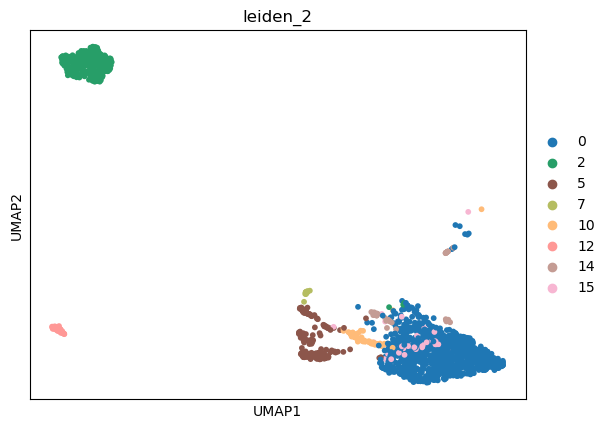

In [6]:
sc.pl.umap(adata_subset,color=['leiden_2'])

[Executed on 2023-10-03 11:39:17.901757]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


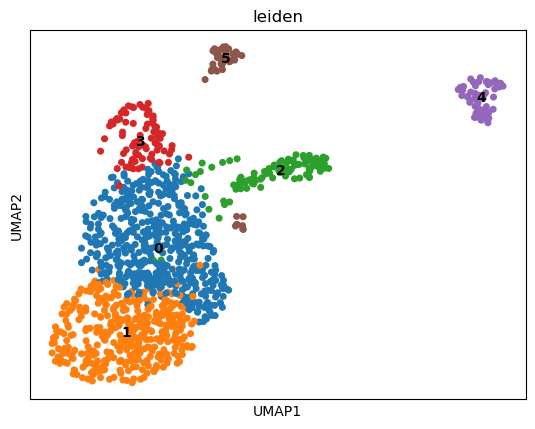

In [70]:
sc.pp.neighbors(adata_subset, n_neighbors=15, n_pcs=15)
sc.tl.leiden(adata_subset, resolution=0.5)
sc.tl.umap(adata_subset, min_dist=0.4)
sc.pl.umap(adata_subset, color=['leiden'], legend_loc='on data')

[Executed on 2023-10-03 10:26:30.400633]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


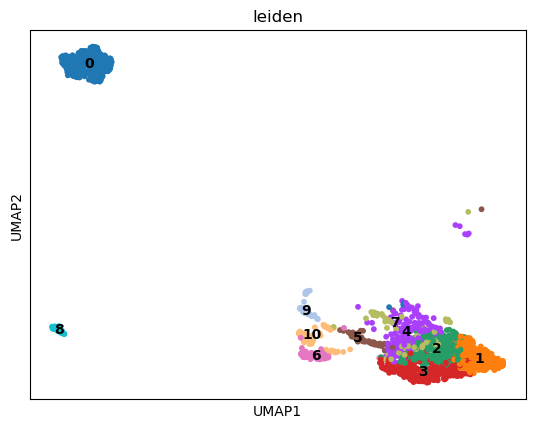

In [8]:
# remove cluster 11
adata_subset=adata_subset[adata_subset.obs['leiden']!='11',:]
sc.pl.umap(adata_subset, color=['leiden'], legend_loc='on data')

[Executed on 2023-10-03 10:47:11.561491]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


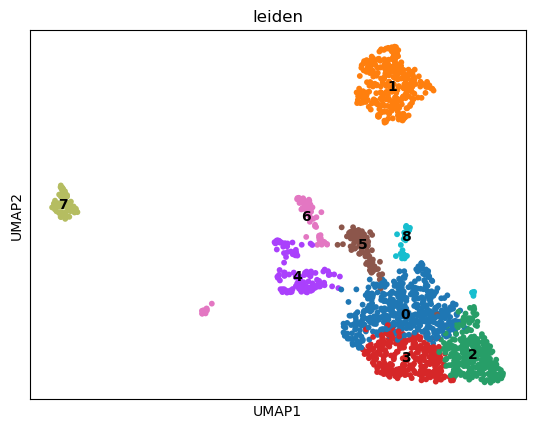

In [22]:
sc.pl.umap(adata_subset, color=['leiden'], legend_loc='on data')

[Executed on 2023-10-03 10:58:10.942986]


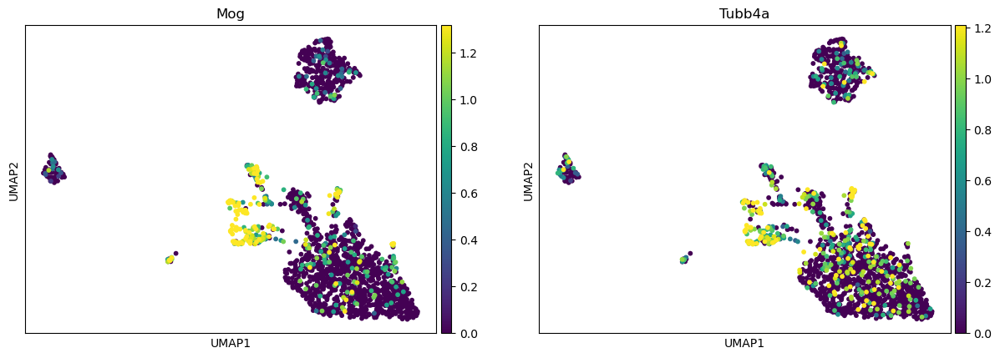

In [27]:
sc.pl.umap(adata_subset,color=['Mog','Tubb4a'],legend_loc='on data',layer='log1p',vmax='p95')

In [38]:
satellite_glial_cells_indices = adata_subset.obs.index[
    (adata_subset.obs['leiden'].isin(['4', '6', '8']))
]

[Executed on 2023-10-03 11:03:58.251740]


In [39]:
satellite_glial_cells_indices

[Executed on 2023-10-03 11:04:00.354967]


Index(['AACGGAATGTATCCTATACG', 'AACGGAATGTCCATGGTTCT', 'AACGGAATGTCTCGTTAACG',
       'AACGGAATGTTCACTTCCAT', 'AAGGCTTGTAAGATGAATGG', 'AAGGCTTGTACACCTCTCCA',
       'AAGGCTTGTACTGCGTAACT', 'AATCTCACTGCACCTCTCCA', 'AATCTCACTGCTCTTCTAGA',
       'ACAATGATCGACGTAGCCAA',
       ...
       'TTCGTCTGCAATCCTATACG', 'TTCGTCTGCATCACTTCCAT', 'TTCGTCTGCATCCAATGTGG',
       'TTGATCTTGGACCATATGAG', 'TTGATCTTGGCTCGTTAACG', 'TTGATCTTGGTCACTTCCAT',
       'TAGACAACACTATGTGGTGA', 'TTCACAGTGTGTGGTTCTCC', 'TTGGAACCGATACGACACTT',
       'TTGTGTTGGAAGTATGTCCA'],
      dtype='object', length=246)

In [41]:
satellite_glial_cells_indices=adata_subset.obs.index[adata_subset.obs['leiden'].isin(['4','6','8'])]

[Executed on 2023-10-03 11:06:13.783488]


In [43]:
adata.obs.loc[satellite_glial_cells_indices, 'cell_type'] = 'Satellite_glial_cells'


[Executed on 2023-10-03 11:07:14.627542]


In [36]:
print(adata.obs['cell_type'].value_counts())


[Executed on 2023-10-03 11:02:53.973926]
cell_type
nan                      1734
Osteocytes                602
chondrocyte               207
Satellite_glial_cells     122
Osteoblasts                73
endothelial                57
Type_1C_neuron             56
Type_1A_neuron             54
immune                     22
Type_1B_neuron             19
Type_2_neuron               8
Name: count, dtype: int64


In [44]:
print(adata.obs['cell_type'].value_counts())


[Executed on 2023-10-03 11:07:26.289254]
cell_type
nan                      1488
Osteocytes                602
Satellite_glial_cells     368
chondrocyte               207
Osteoblasts                73
endothelial                57
Type_1C_neuron             56
Type_1A_neuron             54
immune                     22
Type_1B_neuron             19
Type_2_neuron               8
Name: count, dtype: int64


[Executed on 2023-10-03 11:07:33.609241]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


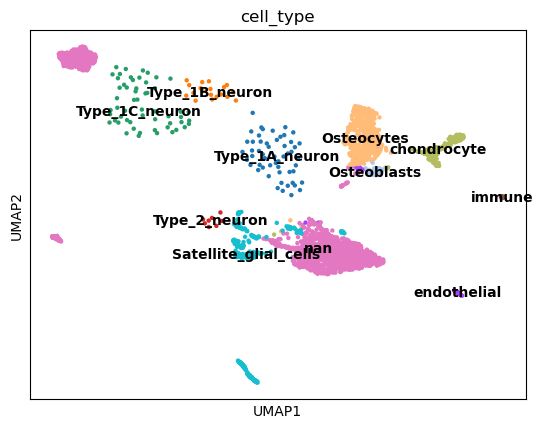

In [45]:
sc.pl.umap(adata,color=['cell_type'],legend_loc='on data')

[Executed on 2023-10-03 11:10:28.476730]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


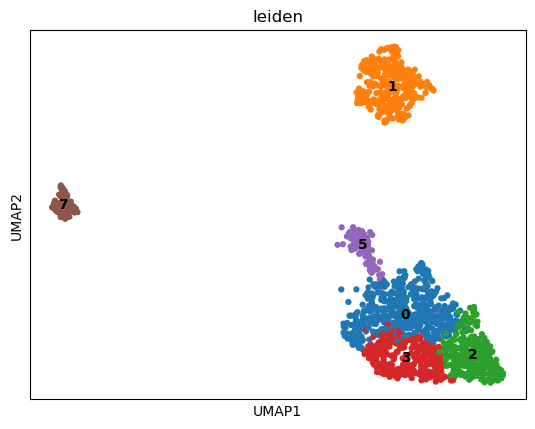

In [47]:
#remove cluster 4,6,8
adata_subset=adata_subset[~adata_subset.obs['leiden'].isin(['4','6','8']),:]

sc.pl.umap(adata_subset,color=['leiden'],legend_loc='on data')

[Executed on 2023-10-03 11:11:56.695612]


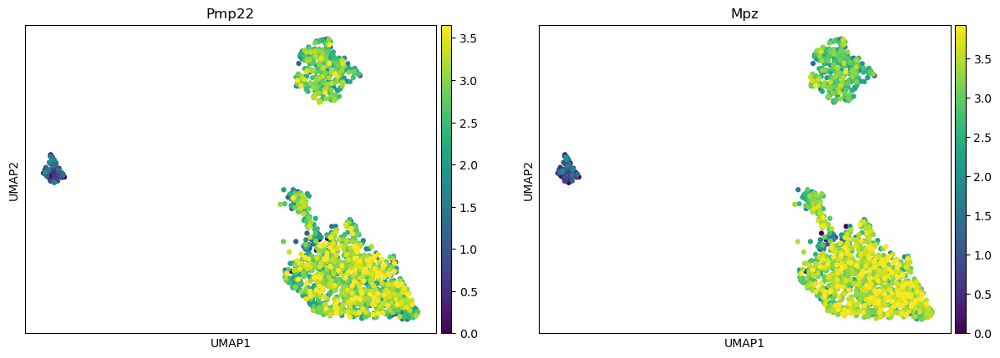

In [50]:
sc.pl.umap(adata_subset,color=['Pmp22','Mpz'],layer='log1p',vmax='p95')

In [51]:
schwann_cells_indeces=adata_subset.obs.index[(adata_subset.obs['leiden'].isin(['1']))]

schwann_cells_indeces

[Executed on 2023-10-03 11:15:47.661175]


Index(['AACCACATCGCCTACTGAAG', 'AACCACATCGTATGCACGCT', 'AACGGAATGTCTCCATTGAG',
       'AACTTAGTGGAGGTGTCGAG', 'AACTTAGTGGCAGGCTGCTT', 'AACTTAGTGGTGACATATGG',
       'AACTTGGTCTCCGTAATGTA', 'AACTTGGTCTTTGCGCTAAT', 'AAGAGGTTCGTGCGGCAGTA',
       'AAGGCCACTACACGGTGGTT',
       ...
       'TTCACAGTGTGACGTCCAGA', 'TTCCATCGGATGTCCTACTA', 'TTCCTTCGAGCAGTGGAGCT',
       'TTCTCACTCTTACAACCTCA', 'TTGAACTGAGTTGTCACGTT', 'TTGAGACTGTAGCTGAATCA',
       'TTGAGACTGTCTCTCACTGG', 'TTGCCTTATCCTCCGCAGTT', 'TTGGAACCGAAGGTCGGTTA',
       'TTGGAACCGACTCTCACTGG'],
      dtype='object', length=306)

In [56]:
# Step 1: Add the new category 'Schwann_cells' to the 'cell_type' column if it's not already present
if 'Schwann_cells' not in adata.obs['cell_type'].cat.categories:
    adata.obs['cell_type'] = adata.obs['cell_type'].cat.add_categories(['Schwann_cells'])

# Step 2: Now assign the 'Schwann_cells' category to the desired cells
adata.obs.loc[schwann_cells_indeces, 'cell_type'] = 'Schwann_cells'

# Step 3: Verify the changes
print(adata.obs['cell_type'].value_counts())


[Executed on 2023-10-03 11:18:36.925577]
cell_type
nan                      1182
Osteocytes                602
Satellite_glial_cells     368
Schwann_cells             306
chondrocyte               207
Osteoblasts                73
endothelial                57
Type_1C_neuron             56
Type_1A_neuron             54
immune                     22
Type_1B_neuron             19
Type_2_neuron               8
Name: count, dtype: int64


[Executed on 2023-10-03 11:42:57.357685]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


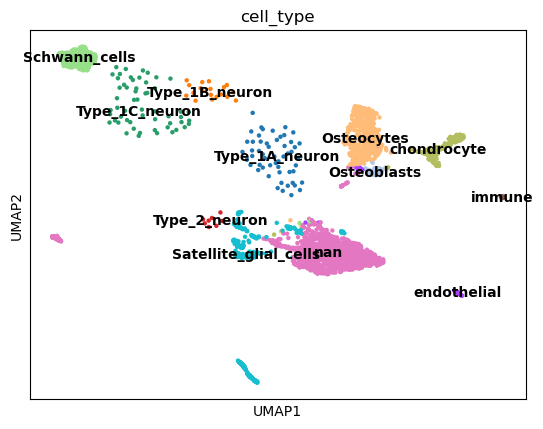

In [83]:
sc.pl.umap(adata,color=['cell_type'],legend_loc='on data')

In [59]:
adata_subset=adata_subset[~adata_subset.obs['leiden'].isin(['1']),:]

[Executed on 2023-10-03 11:20:07.087822]


[Executed on 2023-10-03 11:20:40.327755]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


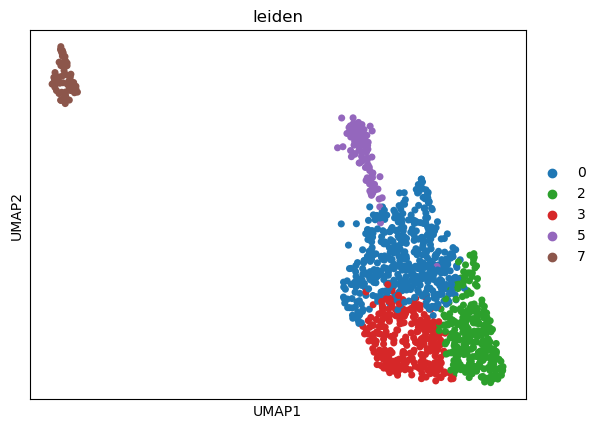

In [61]:
sc.pl.umap(adata_subset,color='leiden')

[Executed on 2023-10-03 11:39:02.162917]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


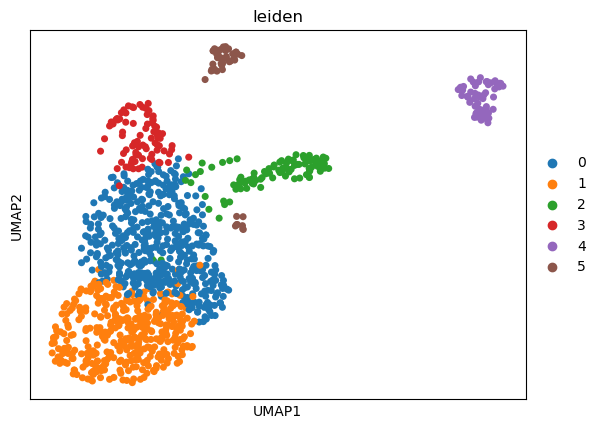

In [69]:
sc.pp.highly_variable_genes(adata_subset,flavor='seurat_v3',n_top_genes=2000,layer='umi')

sc.pp.pca(adata_subset)

sc.pp.neighbors(adata_subset,n_neighbors=15,n_pcs=15)

sc.tl.umap(adata_subset,min_dist=0.4)

sc.tl.leiden(adata_subset,resolution=0.5)

sc.pl.umap(adata_subset,color='leiden')

In [66]:
adata_subset.obsm['X_umap_before']=adata_subset.obsm['X_umap'].copy()

[Executed on 2023-10-03 11:36:09.929936]


In [73]:
adata_subset

[Executed on 2023-10-03 11:41:12.934619]


AnnData object with n_obs × n_vars = 1165 × 33241
    obs: 'sample_ID_Plate', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'doublet_scores', 'predicted_doublets', 'sex', 'leiden_new', 'leiden_old', 'leiden_0', 'leiden_2', 'cell_type'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'cell_type_colors', 'hvg', 'leiden', 'leiden_0_colors', 'leiden_2_colors', 'leiden_new_colors', 'leiden_old_colors', 'leiden_sub_colors', 'log1p', 'neighbors', 'rank_genes_groups', 'sample_ID_Plate_colors', 'umap', 'leiden_colors', 'pca'
    obsm: 'X_pca', 'X_umap', 'X_umapOriginal', 'X_umap_before'
    varm: 'PCs'
    layers: 'Scale', 'log1p', 'umi'
    obsp: 'connectivities', 'distances'

[Executed on 2023-10-03 11:45:22.245008]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


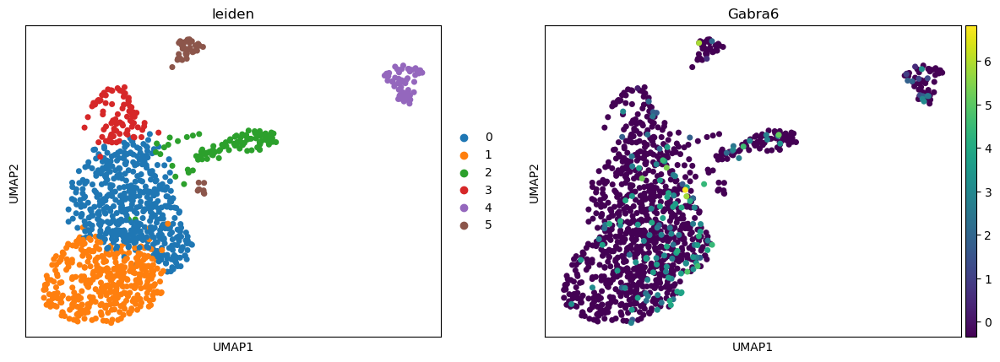

In [84]:
sc.pl.umap(adata_subset,color=['leiden','Gabra6'])

In [85]:
del adata_subset.uns['log1p']
sc.tl.rank_genes_groups(adata_subset, 'leiden', method='t-test')

import pandas as pd
#convert marker genes to dataframe
marker_table=adata_subset.uns['rank_genes_groups']['names']
marker_table=pd.DataFrame(marker_table)
marker_table.head(20)

[Executed on 2023-10-03 11:46:13.180431]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2

,0,1,2,3,4,5
0,Pmp22,Utrn,Gfap,Gm29216,Adgrb3,Ank3
1,Mpz,Hcn1,Apoe,rRNA_rnacentral_341,Cntn1,Cdh19
2,Snhg11,Qk,Cemip,rRNA_rnacentral_223,Ntm,Sox6
3,Meg3,Fryl,Aqp4,mt-Co1,Ctnnd2,Slc35f1
4,Cd9,Ctnna3,Trpm3,Fth1,Slc39a12,Scn7a
5,Mbp,Mctp1,Ptgds,Gm10925,Ptprz1,Ncam1
6,Smtn,Shc4,Adamts12,Sspn,Luzp2,Gm29683
7,Cntnap2,Gulp1,Malat1,Gm28437,Slc4a4,Plce1
8,Gm28437,Sdk1,Sparcl1,Camk1d,Macf1,Abca8a
9,Snap25,Arhgap24,Cped1,mt-Nd4,Aqp4,Prex2


[Executed on 2023-10-03 11:48:31.711123]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


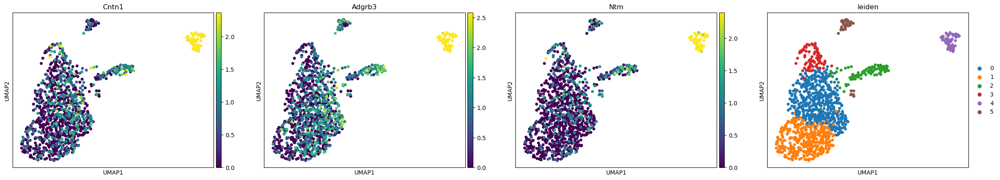

In [88]:
sc.pl.umap(adata_subset,color=['Cntn1','Adgrb3','Ntm','leiden'],vmax='p95',layer='log1p')

[Executed on 2023-10-03 11:49:09.730041]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


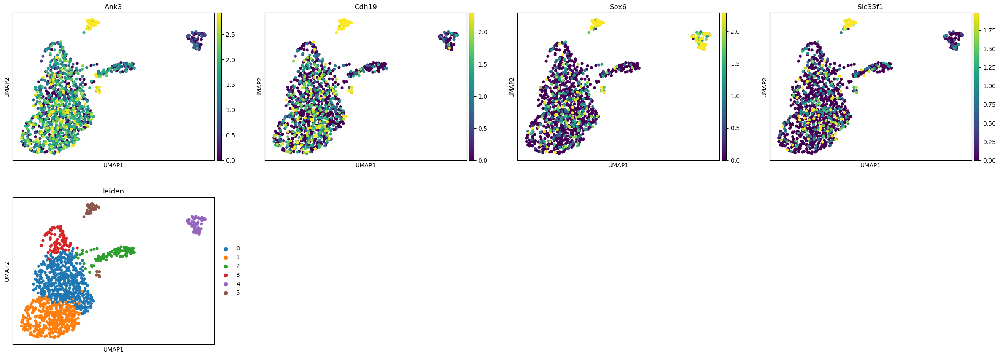

In [89]:
sc.pl.umap(adata_subset,color=['Ank3','Cdh19','Sox6','Slc35f1','leiden'],vmax='p95',layer='log1p')

[Executed on 2023-10-03 13:30:03.862368]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


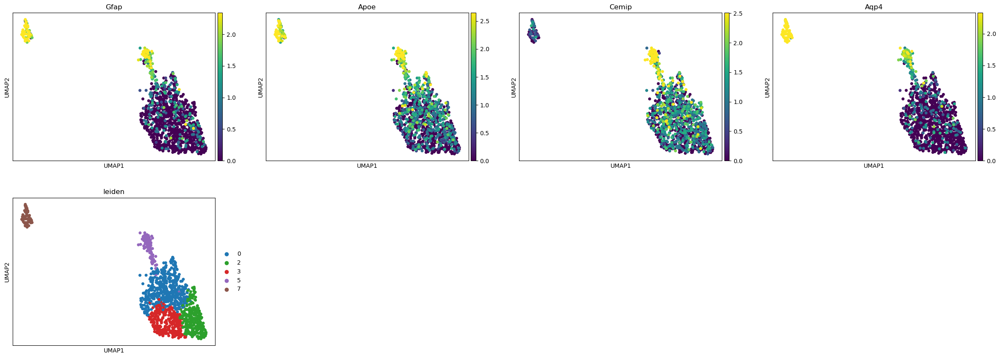

In [4]:
sc.pl.umap(adata_subset,color=['Gfap','Apoe','Cemip','Aqp4','leiden'],vmax='p95',layer='log1p')

In [51]:
adata_subset

[Executed on 2023-10-03 14:06:03.227979]


AnnData object with n_obs × n_vars = 1165 × 33241
    obs: 'sample_ID_Plate', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'doublet_scores', 'predicted_doublets', 'sex', 'leiden_new', 'leiden_old', 'leiden_0', 'leiden_2', 'cell_type'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'cell_type_colors', 'hvg', 'leiden', 'leiden_0_colors', 'leiden_2_colors', 'leiden_colors', 'leiden_new_colors', 'leiden_old_colors', 'leiden_sub_colors', 'neighbors', 'rank_genes_groups', 'sample_ID_Plate_colors', 'umap'
    obsm: 'X_pca', 'X_umap', 'X_umapOriginal'
    layers: 'Scale', 'log1p', 'umi'
    obsp: 'connectivities', 'distances'

[Executed on 2023-10-03 15:57:10.453718]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


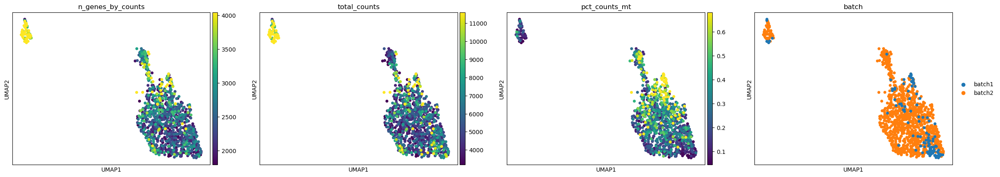

In [67]:
sc.pl.umap(adata_subset,color=['n_genes_by_counts','total_counts','pct_counts_mt','batch'],vmin='p5',vmax='p95')

[Executed on 2023-10-03 14:09:55.169239]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


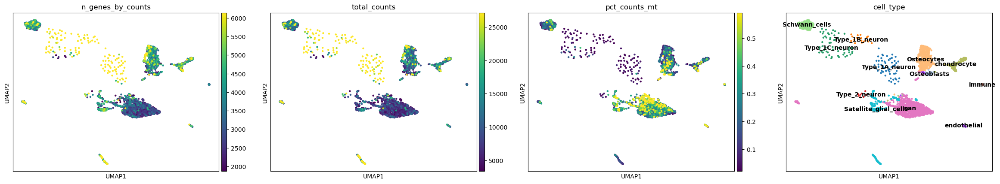

In [58]:
sc.pl.umap(adata,color=['n_genes_by_counts','total_counts','pct_counts_mt','cell_type'],vmin='p5',vmax='p95',legend_loc='on data')

[Executed on 2023-10-03 13:38:10.674755]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


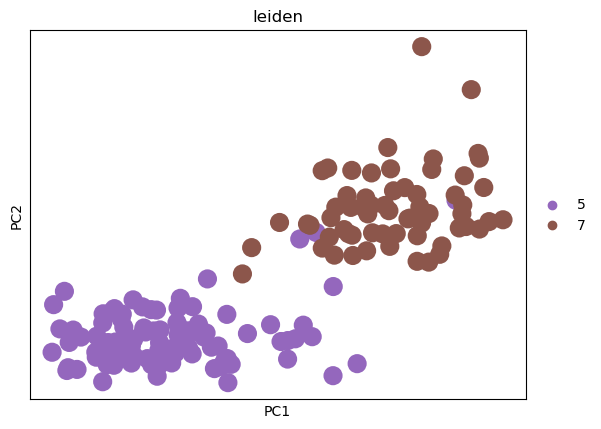

In [7]:
subcluster5_7=adata_subset[adata_subset.obs['leiden'].isin(['5','7']),:]

sc.pl.pca(adata_subset,color=['leiden'])

[Executed on 2023-10-03 14:37:33.611193]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2

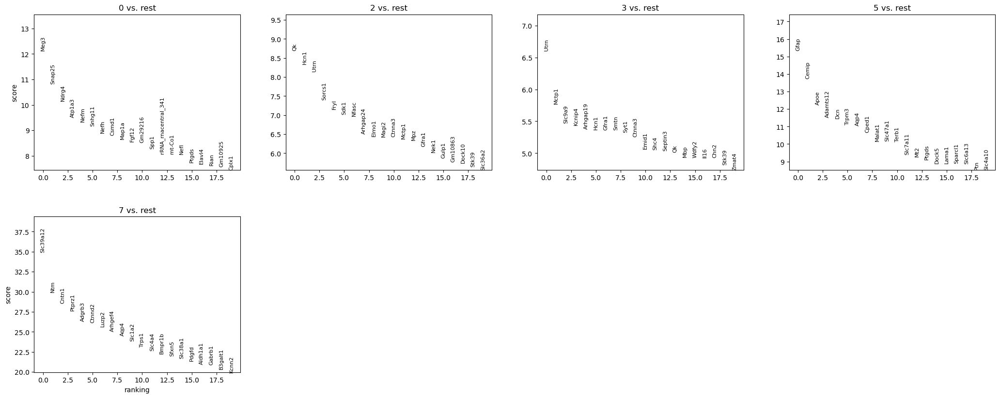

In [59]:
sc.tl.rank_genes_groups(adata_subset,method='t-test_overestim_var',groupby='leiden')
sc.pl.rank_genes_groups(adata_subset,sharey=False)

In [64]:
sc.get.rank_genes_groups_df(adata_subset,pval_cutoff=0.05,group='7',log2fc_min=0)

[Executed on 2023-10-03 14:41:03.105873]


,names,scores,logfoldchanges,pvals,pvals_adj
0,Sema6d,17.448799,7.129388,1.241184e-32,1.289319e-29
1,Sox6,12.653968,6.298042,5.445038e-24,2.080443e-21
2,Dtna,12.250471,5.378571,6.457182e-22,2.083914e-19
3,Gpr37l1,11.318998,11.602434,7.345598e-20,1.808704e-17
4,Ank,9.908992,5.600251,1.099980e-16,1.856063e-14
...,...,...,...,...,...
102,Ptgds,-5.657425,2.132037,1.089778e-07,5.704774e-06
103,Svil,-5.992084,4.133883,3.953377e-08,2.246397e-06
104,Slc38a2,-6.426780,1.840293,5.733101e-09,3.629981e-07
105,Tgfbr3,-7.041523,5.268981,1.513605e-10,1.195101e-08


[Executed on 2023-10-03 14:41:13.011762]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


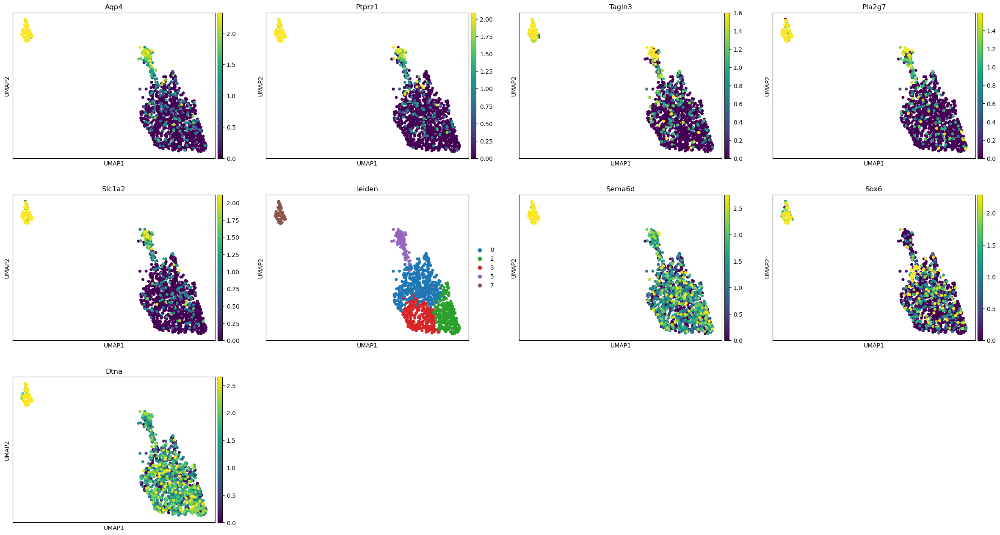

In [65]:
sc.pl.umap(adata_subset,color=['Aqp4','Ptprz1','Tagln3','Pla2g7','Slc1a2','leiden','Sema6d','Sox6','Dtna'],layer='log1p',vmax='p95')

[Executed on 2023-10-03 13:59:19.030563]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


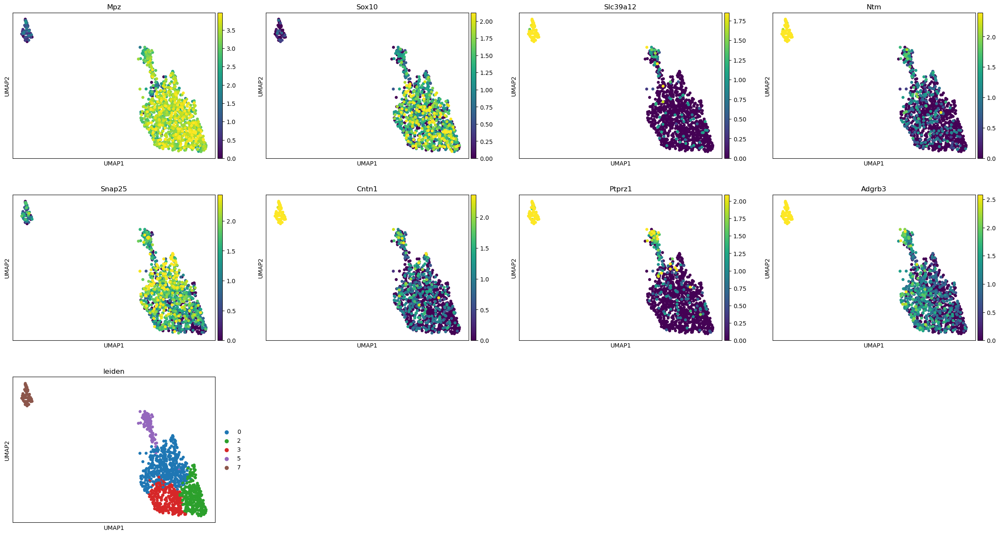

In [38]:
sc.pl.umap(adata_subset,color=['Mpz','Sox10','Slc39a12','Ntm','Snap25','Cntn1','Ptprz1','Adgrb3','leiden'],layer='log1p',vmax='p95')

[Executed on 2023-10-03 13:42:35.023416]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


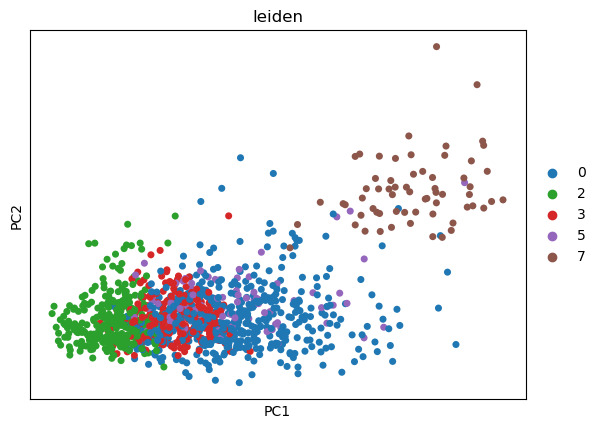

In [10]:
sc.pl.pca(adata_subset,color=['leiden'])

In [25]:
adata_subset.obs['leiden'].value_counts()

[Executed on 2023-10-03 13:48:24.896212]


leiden
0    467
2    277
3    263
5     95
7     63
Name: count, dtype: int64

In [33]:
c7=sc.get.rank_genes_groups_df(adata_subset,pval_cutoff=0.05,group='7',log2fc_min=0)



[Executed on 2023-10-03 13:52:37.172951]


In [35]:
c7

[Executed on 2023-10-03 13:53:31.957504]


,names,scores,logfoldchanges,pvals,pvals_adj
0,Sema6d,17.448799,7.129388,1.241184e-32,1.289319e-29
1,Sox6,12.653968,6.298042,5.445038e-24,2.080443e-21
2,Dtna,12.250471,5.378571,6.457182e-22,2.083914e-19
3,Gpr37l1,11.318998,11.602434,7.345598e-20,1.808704e-17
4,Ank,9.908992,5.600251,1.099980e-16,1.856063e-14
...,...,...,...,...,...
102,Ptgds,-5.657425,2.132037,1.089778e-07,5.704774e-06
103,Svil,-5.992084,4.133883,3.953377e-08,2.246397e-06
104,Slc38a2,-6.426780,1.840293,5.733101e-09,3.629981e-07
105,Tgfbr3,-7.041523,5.268981,1.513605e-10,1.195101e-08


In [42]:
import gseapy as gp

[Executed on 2023-10-09 10:41:01.032351]


In [36]:
enr_up=gp.enrichr(c7.names,gene_sets=['GO_Biological_Process_2023'],organism='Mouse',outdir=None)

[Executed on 2023-10-03 13:54:23.164057]


[Executed on 2023-10-03 13:54:45.721496]


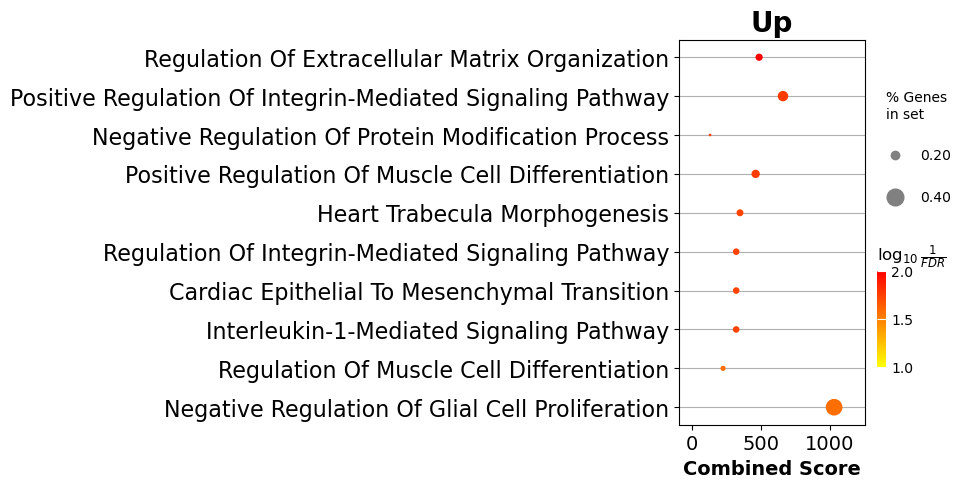

In [37]:
enr_up.res2d.Term = enr_up.res2d.Term.str.split(" \(GO").str[0]

gp.dotplot(enr_up.res2d, figsize=(3,5), title="Up", cmap = plt.cm.autumn_r)
plt.show()

[Executed on 2023-10-03 16:00:50.368942]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


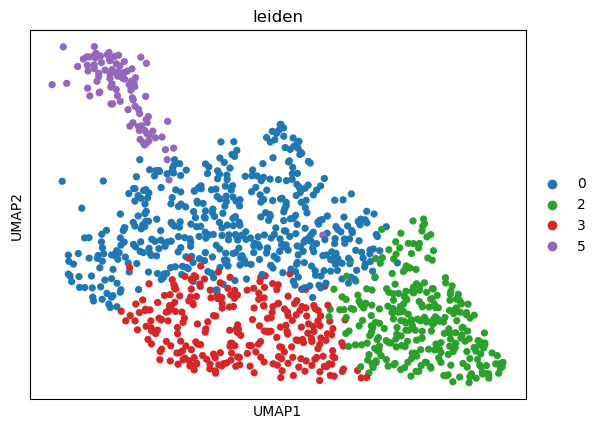

In [70]:
subset_without_unknown=adata_subset[~adata_subset.obs['leiden'].isin(['7'])]

sc.pl.umap(subset_without_unknown,color='leiden')

[Executed on 2023-10-03 16:01:17.859926]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:149: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['hvg'] = {'flavor': 'seurat_v3'}
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it

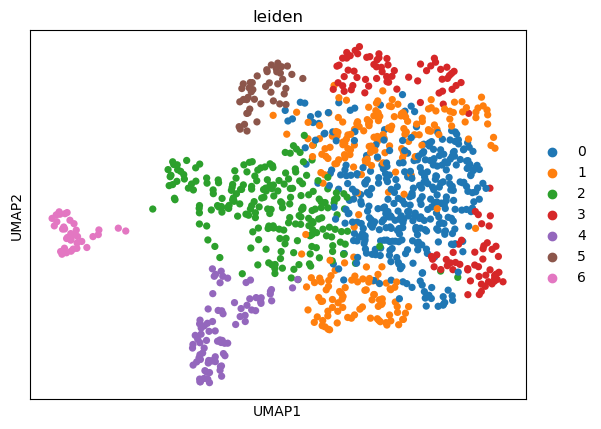

In [71]:
sc.pp.highly_variable_genes(subset_without_unknown,flavor='seurat_v3',n_top_genes=500,layer='umi')

sc.pp.pca(subset_without_unknown)

sc.pp.neighbors(subset_without_unknown,n_neighbors=15,n_pcs=15)

sc.tl.leiden(subset_without_unknown,resolution=0.5)


sc.tl.umap(subset_without_unknown,min_dist=0.4)

sc.pl.umap(subset_without_unknown,color='leiden')

[Executed on 2023-10-03 16:05:20.268218]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


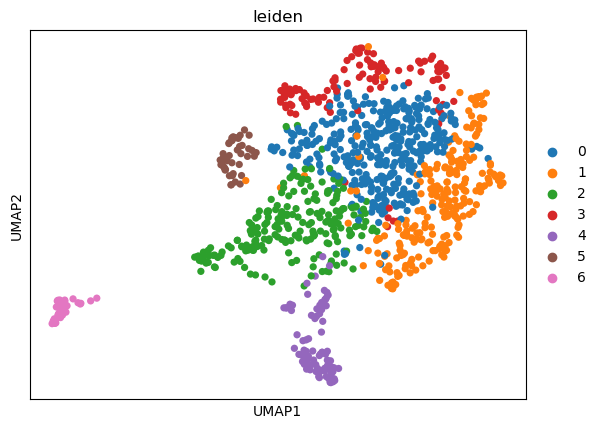

In [73]:
sc.pp.neighbors(subset_without_unknown,n_neighbors=15,n_pcs=15)
sc.tl.leiden(subset_without_unknown,resolution=0.5)
sc.tl.umap(subset_without_unknown,min_dist=0.2)
sc.pl.umap(subset_without_unknown,color='leiden')
sc.pl.pca(subset_without_unknown,color='leiden')

[Executed on 2023-10-03 16:05:56.289474]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


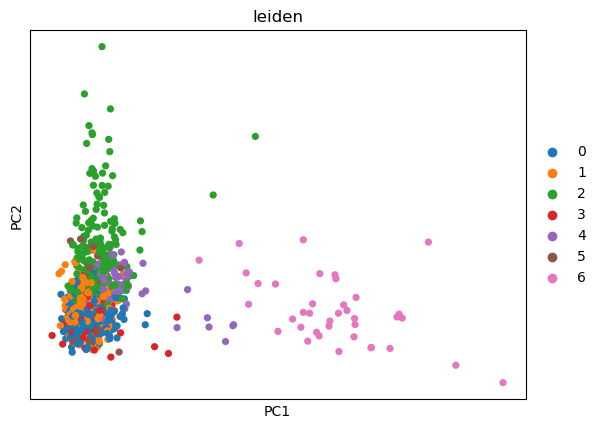

In [74]:
sc.pl.pca(subset_without_unknown,color='leiden')

In [111]:
subset_without_unknown.write_h5ad("/proj/sensoryaging/data/data/up_dated_data/SGNs/final_with_neuronIV_with_annotated_subset_without_unknown.h5ad")

[Executed on 2023-10-03 16:28:53.603525]


TypeError: Can't implicitly convert non-string objects to strings

Above error raised while writing key 'names' of <class 'h5py._hl.group.Group'> to /

In [97]:
sc.tl.rank_genes_groups(subset_without_unknown,method='t-test_overestim_var',groupby='leiden')

[Executed on 2023-10-03 16:15:29.180997]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2

In [102]:
a=sc.get.rank_genes_groups_df(subset_without_unknown,pval_cutoff=0.05,group='6')
a.head(20)

[Executed on 2023-10-03 16:16:37.808260]


,names,scores,logfoldchanges,pvals,pvals_adj
0,Cdh19,16.840738,7.580139,1.374447e-25,4.568800e-21
1,Scn7a,15.293898,NaN,3.876062e-18,4.294806e-14
2,Abca8a,13.216716,NaN,2.215540e-17,1.841169e-13
3,Sox6,12.400324,8.840964,1.116123e-19,1.855052e-15
4,Slc35f1,11.367689,13.426785,1.681558e-16,9.316109e-13
5,Prex2,11.281247,NaN,4.473357e-15,1.239157e-11
6,Ank3,10.272654,5.231384,1.984459e-15,6.596540e-12
7,Abca8b,9.728178,NaN,3.469864e-13,8.158549e-10
8,Lpar1,8.591096,NaN,9.460041e-12,1.310255e-08
9,Grik2,8.486569,NaN,2.812119e-12,4.673882e-09


[Executed on 2023-10-03 16:27:27.705428]


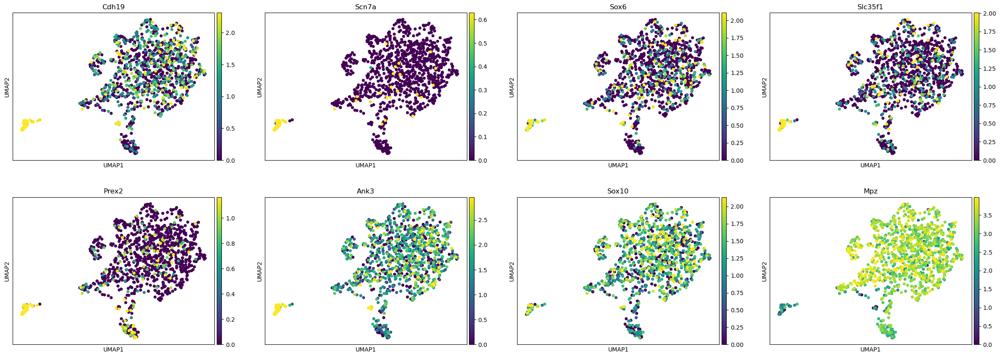

In [110]:
sc.pl.umap(subset_without_unknown,color=['Cdh19','Scn7a','Sox6','Slc35f1','Prex2','Ank3','Sox10','Mpz'],layer='log1p',vmax='p95')

In [104]:
subset_without_unknown

[Executed on 2023-10-03 16:18:29.183753]


AnnData object with n_obs × n_vars = 1102 × 33241
    obs: 'sample_ID_Plate', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'doublet_scores', 'predicted_doublets', 'sex', 'leiden_new', 'leiden_old', 'leiden_0', 'leiden_2', 'cell_type'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'cell_type_colors', 'hvg', 'leiden', 'leiden_0_colors', 'leiden_2_colors', 'leiden_colors', 'leiden_new_colors', 'leiden_old_colors', 'leiden_sub_colors', 'neighbors', 'rank_genes_groups', 'sample_ID_Plate_colors', 'umap', 'batch_colors', 'pca', 'rank_genes_groups_filtered'
    obsm: 'X_pca', 'X_umap', 'X_umapOriginal'
    varm: 'PCs'
    layers: 'Scale', 'log1p', 'umi'
    obsp: 'connectivities', 'distances'

[Executed on 2023-10-03 16:20:14.903087]


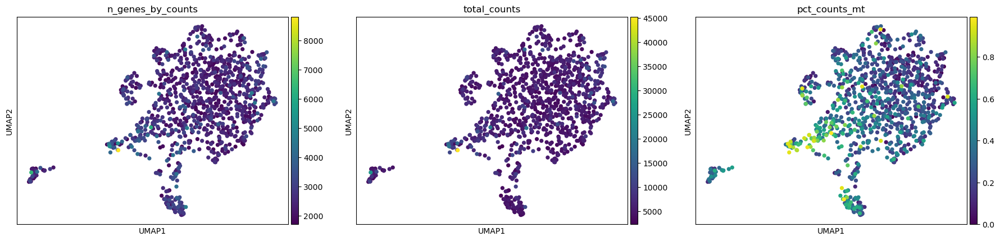

In [108]:
sc.pl.umap(subset_without_unknown,color=['n_genes_by_counts','total_counts','pct_counts_mt'])

### try with adata satelite glial cell

[Executed on 2023-10-03 16:06:39.812832]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


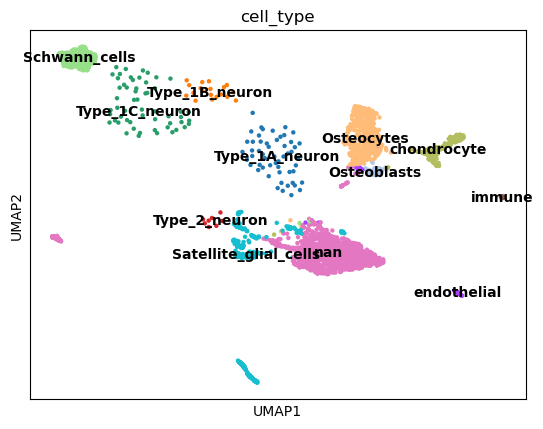

In [75]:
sc.pl.umap(adata,color=['cell_type'],legend_loc='on data')

In [76]:
adata.obs['cell_type'].value_counts()

[Executed on 2023-10-03 16:06:49.248264]


cell_type
nan                      1182
Osteocytes                602
Satellite_glial_cells     368
Schwann_cells             306
chondrocyte               207
Osteoblasts                73
endothelial                57
Type_1C_neuron             56
Type_1A_neuron             54
immune                     22
Type_1B_neuron             19
Type_2_neuron               8
Name: count, dtype: int64

[Executed on 2023-10-03 16:07:23.097522]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


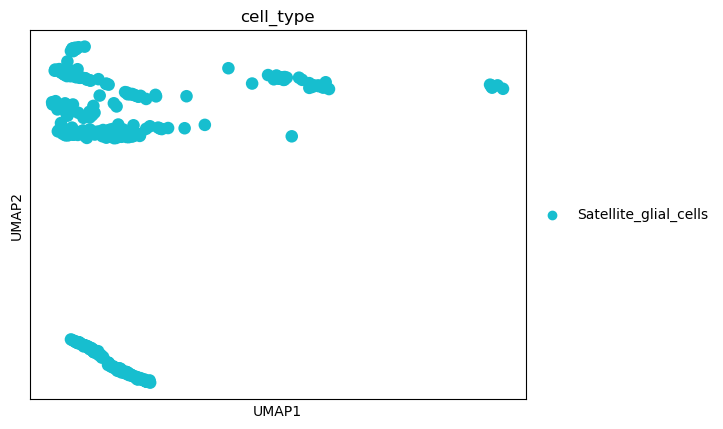

In [78]:
Satellite_glial_cells=adata[adata.obs['cell_type']=='Satellite_glial_cells',:]

sc.pl.umap(Satellite_glial_cells,color=['cell_type'])

[Executed on 2023-10-03 16:07:47.784758]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


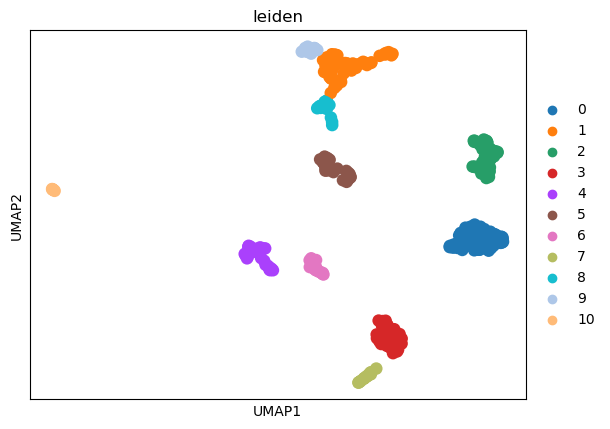

/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


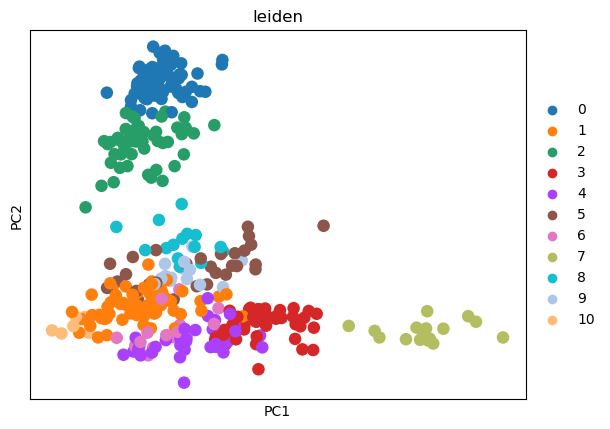

In [79]:
sc.pp.neighbors(Satellite_glial_cells,n_neighbors=5,n_pcs=15)
sc.tl.leiden(Satellite_glial_cells,resolution=0.5)
sc.tl.umap(Satellite_glial_cells,min_dist=0.2)
sc.pl.umap(Satellite_glial_cells,color='leiden')
sc.pl.pca(Satellite_glial_cells,color='leiden')

[Executed on 2023-10-03 16:10:05.803743]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


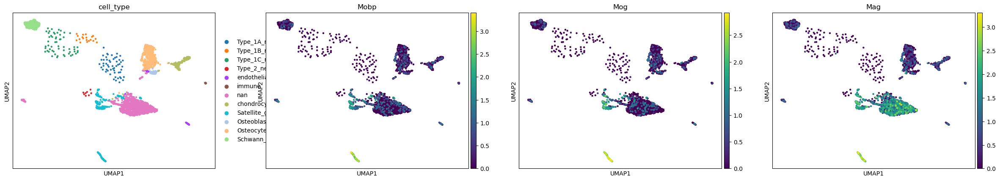

In [83]:
sc.pl.umap(adata,color=['cell_type','Mobp','Mog','Mag'],layer='log1p')

[Executed on 2023-10-03 16:10:22.458154]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


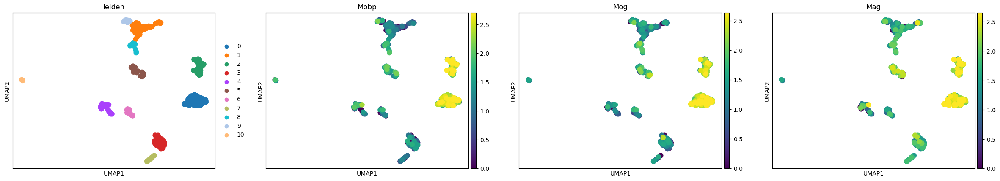

In [84]:
sc.pl.umap(Satellite_glial_cells,color=['leiden','Mobp','Mog','Mag'],layer='log1p',vmax='p95')

[Executed on 2023-10-03 16:10:41.074637]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


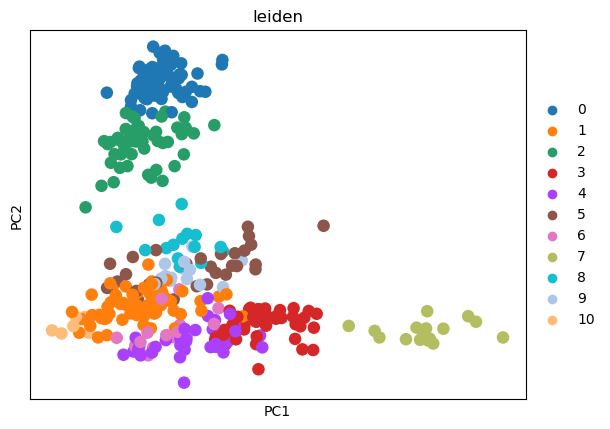

In [85]:
sc.pl.pca(Satellite_glial_cells,color=['leiden'])

[Executed on 2023-10-03 16:34:47.458889]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


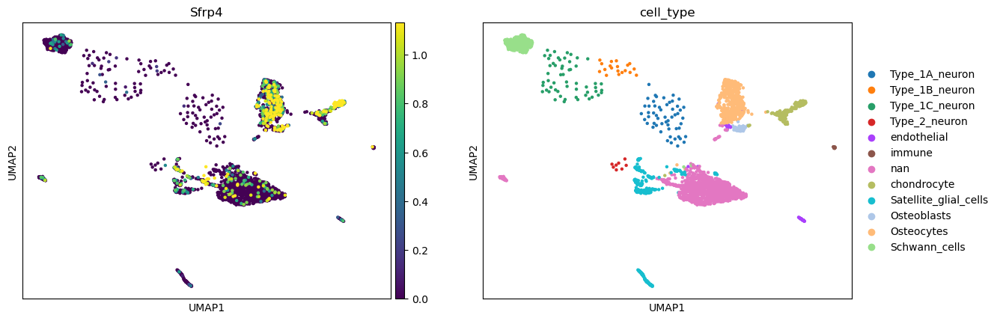

In [113]:
sc.pl.umap(adata,color=['Sfrp4','cell_type'],layer='log1p',vmax='p95')

In [1]:
import scanpy as sc

[Executed on 2023-10-09 10:06:09.324381]


In [2]:
unknown=sc.read_h5ad("/proj/sensoryaging/data/data/up_dated_data/SGNs/final_with_neuronIV_with_annotated_subset_without_unknown.h5ad")
unknown

[Executed on 2023-10-09 10:08:46.980806]


AnnData object with n_obs × n_vars = 1102 × 33241
    obs: 'sample_ID_Plate', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'doublet_scores', 'predicted_doublets', 'sex', 'leiden_new', 'leiden_old', 'leiden_0', 'leiden_2', 'cell_type'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'batch_colors', 'cell_type_colors', 'hvg', 'leiden', 'leiden_0_colors', 'leiden_2_colors', 'leiden_colors', 'leiden_new_colors', 'leiden_old_colors', 'leiden_sub_colors', 'neighbors', 'pca', 'rank_genes_groups', 'rank_genes_groups_filtered', 'sample_ID_Plate_colors', 'umap'
    obsm: 'X_pca', 'X_umap', 'X_umapOriginal'
    varm: 'PCs'
    layers: 'Scale', 'log1p', 'umi'
    obsp: 'connectivities', 'distances'

In [3]:
subset_without_unknown=sc.read_h5ad("/proj/sensoryaging/data/data/up_dated_data/SGNs/final_with_neuronIV_with_annotated_subset_without_unknown.h5ad")

[Executed on 2023-10-09 10:08:49.940853]


In [7]:
subset_without_unknown

[Executed on 2023-10-09 10:12:03.617411]


AnnData object with n_obs × n_vars = 1102 × 33241
    obs: 'sample_ID_Plate', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'doublet_scores', 'predicted_doublets', 'sex', 'leiden_new', 'leiden_old', 'leiden_0', 'leiden_2', 'cell_type'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'batch_colors', 'cell_type_colors', 'hvg', 'leiden', 'leiden_0_colors', 'leiden_2_colors', 'leiden_colors', 'leiden_new_colors', 'leiden_old_colors', 'leiden_sub_colors', 'neighbors', 'pca', 'rank_genes_groups', 'rank_genes_groups_filtered', 'sample_ID_Plate_colors', 'umap'
    obsm: 'X_pca', 'X_umap', 'X_umapOriginal'
    varm: 'PCs'
    layers: 'Scale', 'log1p', 'umi'
    obsp: 'connectivities', 'distances'

[Executed on 2023-10-09 10:12:26.498508]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


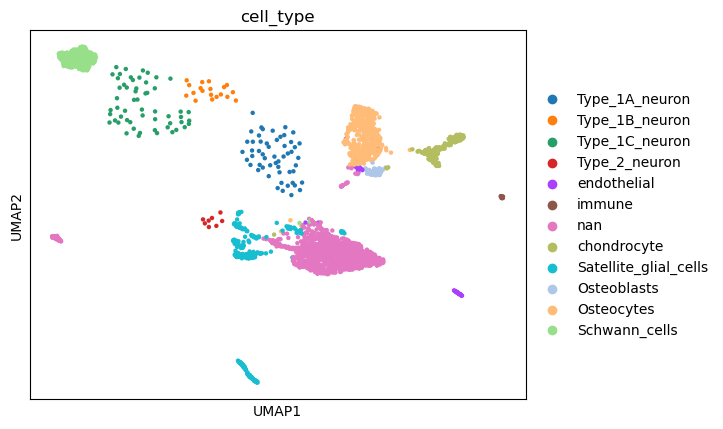

In [10]:
sc.pl.umap(adata,color='cell_type')

[Executed on 2023-10-09 10:13:01.862219]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


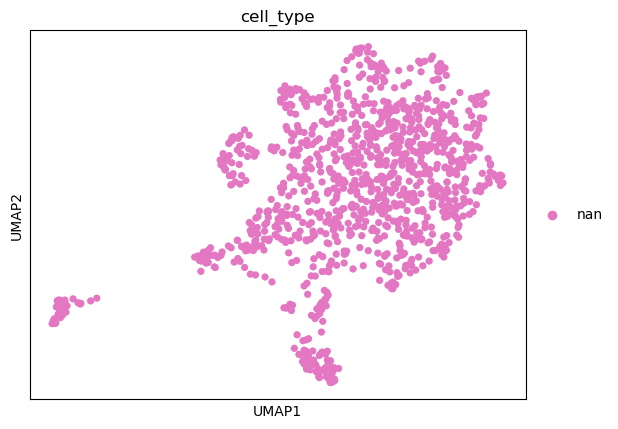

In [12]:
sc.pl.umap(unknown,color='cell_type')

In [16]:
subset_without_unknown.obs['cell_type'].value_counts()

[Executed on 2023-10-09 10:13:57.488591]


cell_type
nan    1102
Name: count, dtype: int64

In [14]:
adata.obs['cell_type'].value_counts()

[Executed on 2023-10-09 10:13:27.263838]


cell_type
nan                      1182
Osteocytes                602
Satellite_glial_cells     368
Schwann_cells             306
chondrocyte               207
Osteoblasts                73
endothelial                57
Type_1C_neuron             56
Type_1A_neuron             54
immune                     22
Type_1B_neuron             19
Type_2_neuron               8
Name: count, dtype: int64

[Executed on 2023-10-09 10:14:42.115732]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


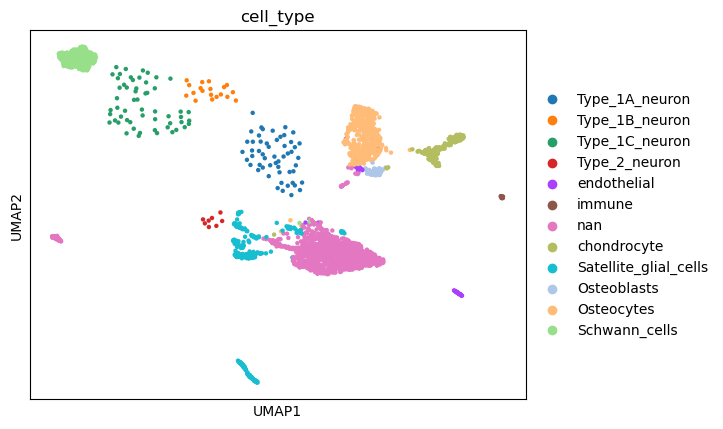

In [17]:
sc.pl.umap(adata,color=['cell_type'],layer='log1p',vmax='p95')

In [18]:
unknown=adata[adata.obs['cell_type']=='nan']

unknown

[Executed on 2023-10-09 10:17:02.241127]


View of AnnData object with n_obs × n_vars = 1182 × 33241
    obs: 'sample_ID_Plate', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'doublet_scores', 'predicted_doublets', 'sex', 'leiden_new', 'leiden_old', 'leiden_0', 'leiden_2', 'cell_type'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'cell_type_colors', 'hvg', 'leiden', 'leiden_2_colors', 'leiden_colors', 'leiden_new_colors', 'leiden_old_colors', 'leiden_sub_colors', 'log1p', 'neighbors', 'rank_genes_groups'
    obsm: 'X_pca', 'X_umap', 'X_umapOriginal'
    layers: 'Scale', 'log1p', 'umi'
    obsp: 'connectivities', 'distances'

[Executed on 2023-10-09 10:17:41.618254]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


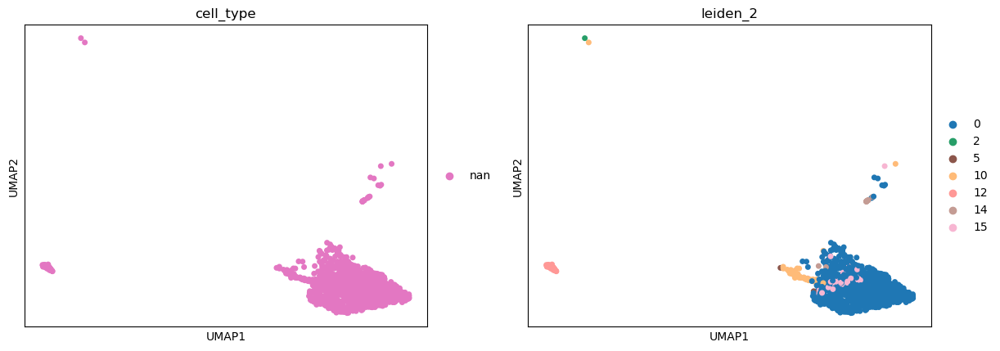

In [21]:
sc.pl.umap(unknown,color=['cell_type','leiden_2'],layer='log1p',vmax='p95')

In [22]:
sc.pp.pca(unknown)
sc.pp.neighbors(unknown,n_neighbors=15,n_pcs=15)
sc.tl.leiden(unknown,resolution=0.5)
sc.tl.umap(unknown,min_dist=0.7)


[Executed on 2023-10-09 10:19:07.356134]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packag

[Executed on 2023-10-09 10:19:42.840399]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


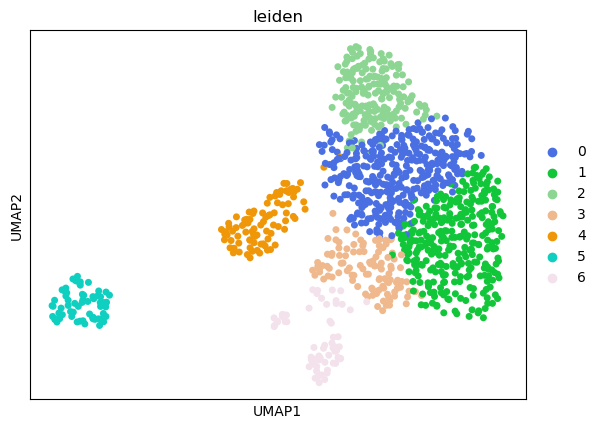

In [23]:
sc.pl.umap(unknown,color=['leiden'],layer='log1p',vmax='p95')

In [25]:
unknown

[Executed on 2023-10-09 10:20:47.603297]


AnnData object with n_obs × n_vars = 1182 × 33241
    obs: 'sample_ID_Plate', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'doublet_scores', 'predicted_doublets', 'sex', 'leiden_new', 'leiden_old', 'leiden_0', 'leiden_2', 'cell_type'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'cell_type_colors', 'hvg', 'leiden', 'leiden_2_colors', 'leiden_colors', 'leiden_new_colors', 'leiden_old_colors', 'leiden_sub_colors', 'log1p', 'neighbors', 'rank_genes_groups', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap', 'X_umapOriginal'
    varm: 'PCs'
    layers: 'Scale', 'log1p', 'umi'
    obsp: 'connectivities', 'distances'

In [26]:
del unknown.uns['log1p']

sc.tl.rank_genes_groups(unknown, 'leiden', method='t-test')

sc.get.rank_genes_groups_df(unknown,pval_cutoff=0.05,group='5',log2fc_min=0)

[Executed on 2023-10-09 10:20:57.694291]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2

,names,scores,logfoldchanges,pvals,pvals_adj
0,Sema6d,30.974239,7.309641,9.430726e-47,3.407465e-44
1,Dtna,21.514900,5.335199,3.572459e-35,8.133705e-33
2,Sox6,18.089195,6.027294,2.275133e-28,3.707239e-26
3,Ank,17.512123,5.581820,2.569476e-29,4.448539e-27
4,Tnik,14.474263,5.153104,3.452718e-24,4.143387e-22
...,...,...,...,...,...
982,Tgfbr3,-11.205865,4.876196,1.038539e-17,7.456170e-16
983,Svil,-12.012317,4.358681,1.741080e-20,1.589979e-18
984,Uaca,-12.141602,2.060696,1.744546e-22,1.835141e-20
985,Slc38a2,-12.794974,1.797017,3.961293e-22,4.051611e-20


In [30]:
unknown

[Executed on 2023-10-09 10:22:35.401347]


AnnData object with n_obs × n_vars = 1182 × 33241
    obs: 'sample_ID_Plate', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'doublet_scores', 'predicted_doublets', 'sex', 'leiden_new', 'leiden_old', 'leiden_0', 'leiden_2', 'cell_type'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'cell_type_colors', 'hvg', 'leiden', 'leiden_2_colors', 'leiden_colors', 'leiden_new_colors', 'leiden_old_colors', 'leiden_sub_colors', 'neighbors', 'rank_genes_groups', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap', 'X_umapOriginal'
    varm: 'PCs'
    layers: 'Scale', 'log1p', 'umi'
    obsp: 'connectivities', 'distances'

[Executed on 2023-10-09 10:23:09.137113]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


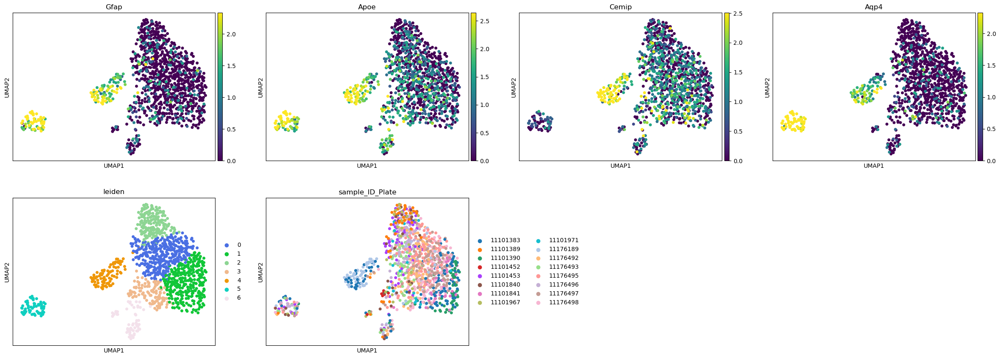

In [33]:
sc.pl.umap(unknown,color=['Gfap','Apoe','Cemip','Aqp4','leiden','sample_ID_Plate'],layer='log1p',vmax='p95')

In [39]:
unknown

[Executed on 2023-10-09 10:38:18.541349]


AnnData object with n_obs × n_vars = 1182 × 33241
    obs: 'sample_ID_Plate', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'doublet_scores', 'predicted_doublets', 'sex', 'leiden_new', 'leiden_old', 'leiden_0', 'leiden_2', 'cell_type'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'cell_type_colors', 'hvg', 'leiden', 'leiden_2_colors', 'leiden_colors', 'leiden_new_colors', 'leiden_old_colors', 'leiden_sub_colors', 'neighbors', 'rank_genes_groups', 'pca', 'umap', 'sample_ID_Plate_colors'
    obsm: 'X_pca', 'X_umap', 'X_umapOriginal'
    varm: 'PCs'
    layers: 'Scale', 'log1p', 'umi'
    obsp: 'connectivities', 'distances'

[Executed on 2023-10-09 10:38:50.163473]


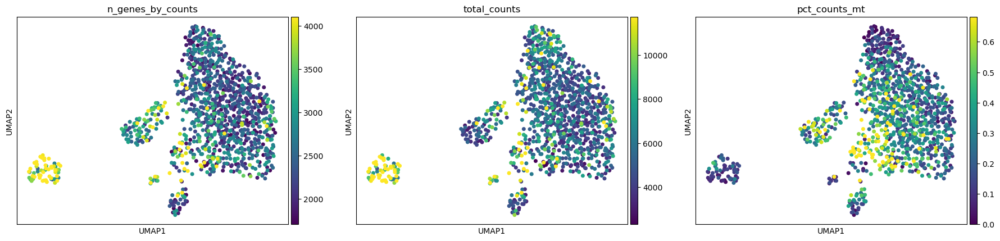

In [41]:
sc.pl.umap(unknown,color=['n_genes_by_counts','total_counts','pct_counts_mt'],layer='log1p',vmax='p95')

In [46]:
u5=sc.get.rank_genes_groups_df(unknown,pval_cutoff=0.1,group='5',log2fc_min=0)
u5

[Executed on 2023-10-09 10:44:46.424665]


,names,scores,logfoldchanges,pvals,pvals_adj
0,Sema6d,30.974239,7.309641,9.430726e-47,3.407465e-44
1,Dtna,21.514900,5.335199,3.572459e-35,8.133705e-33
2,Sox6,18.089195,6.027294,2.275133e-28,3.707239e-26
3,Ank,17.512123,5.581820,2.569476e-29,4.448539e-27
4,Tnik,14.474263,5.153104,3.452718e-24,4.143387e-22
...,...,...,...,...,...
1386,Tgfbr3,-11.205865,4.876196,1.038539e-17,7.456170e-16
1387,Svil,-12.012317,4.358681,1.741080e-20,1.589979e-18
1388,Uaca,-12.141602,2.060696,1.744546e-22,1.835141e-20
1389,Slc38a2,-12.794974,1.797017,3.961293e-22,4.051611e-20


[Executed on 2023-10-09 10:45:38.403974]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


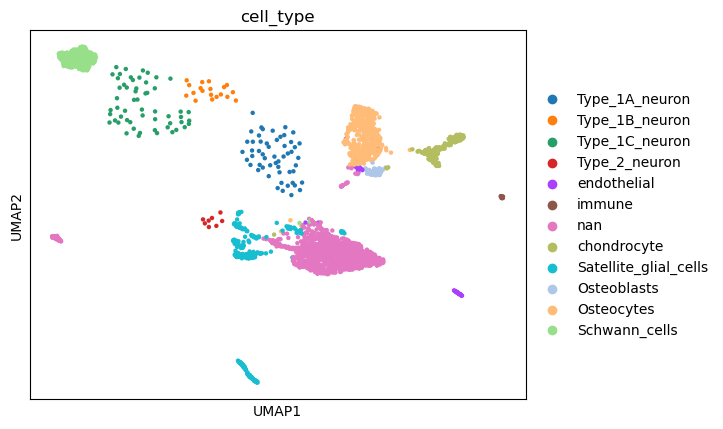

In [48]:
sc.pl.umap(adata,color=['cell_type'])

[Executed on 2023-10-09 10:46:53.124891]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


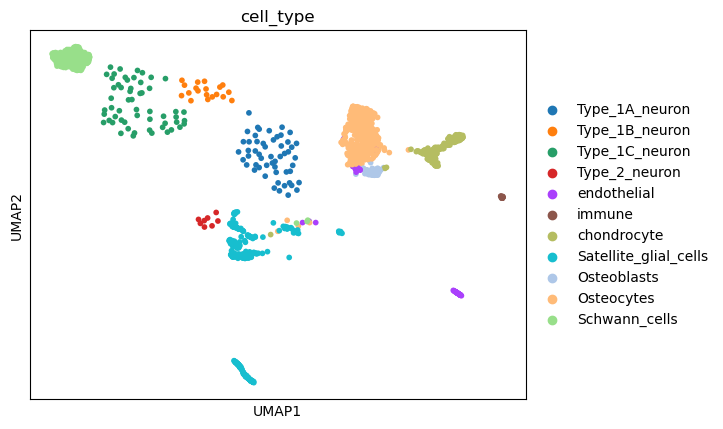

In [50]:
known_cluster=adata[~adata.obs['cell_type'].isin(['nan'])]
sc.pl.umap(known_cluster,color=['cell_type'])

In [53]:
known_cluster

[Executed on 2023-10-09 10:47:39.704520]


AnnData object with n_obs × n_vars = 1772 × 33241
    obs: 'sample_ID_Plate', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'doublet_scores', 'predicted_doublets', 'sex', 'leiden_new', 'leiden_old', 'leiden_0', 'leiden_2', 'cell_type'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'cell_type_colors', 'hvg', 'leiden', 'leiden_2_colors', 'leiden_colors', 'leiden_new_colors', 'leiden_old_colors', 'leiden_sub_colors', 'log1p', 'neighbors', 'rank_genes_groups'
    obsm: 'X_pca', 'X_umap', 'X_umapOriginal', 'X_umap_before'
    layers: 'Scale', 'log1p', 'umi'
    obsp: 'connectivities', 'distances'

In [52]:
known_cluster.obsm['X_umap_before']=known_cluster.obsm['X_umap'].copy()

[Executed on 2023-10-09 10:47:22.669760]


[Executed on 2023-10-09 10:48:40.624269]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


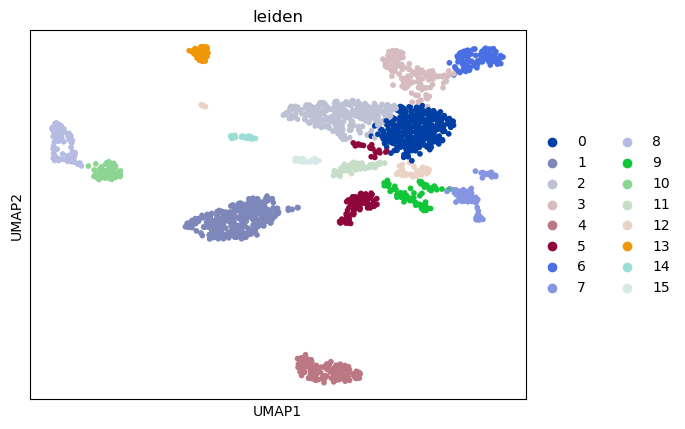

In [54]:
sc.pp.highly_variable_genes(known_cluster,flavor='seurat_v3',n_top_genes=1000,layer='umi')

sc.pp.pca(known_cluster)

sc.pp.neighbors(known_cluster,n_neighbors=15,n_pcs=15)

sc.tl.umap(known_cluster,min_dist=0.6)

sc.tl.leiden(known_cluster,resolution=0.5)

sc.pl.umap(known_cluster,color='leiden')

[Executed on 2023-10-09 10:50:20.217295]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


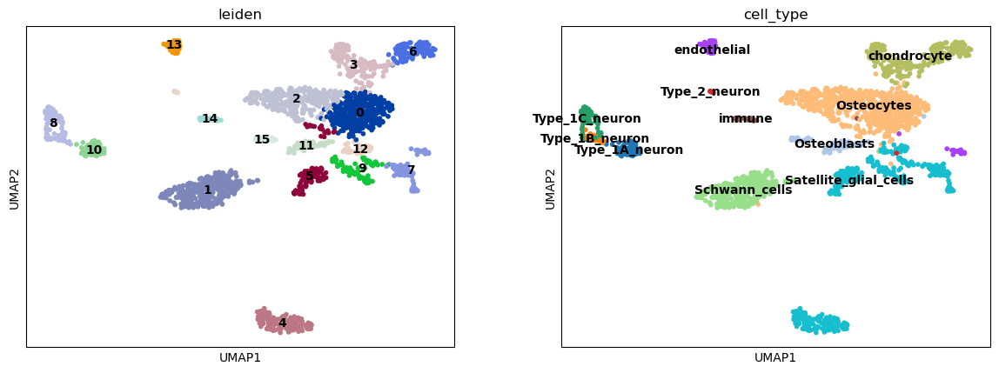

In [56]:
sc.pl.umap(known_cluster,color=['leiden','cell_type'],legend_loc='on data')

[Executed on 2023-10-09 10:53:39.403225]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


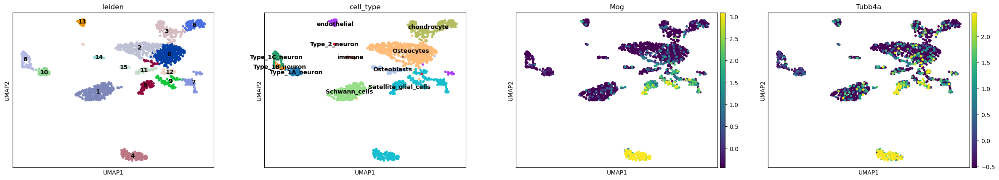

In [59]:
sc.pl.umap(known_cluster,color=['leiden','cell_type','Mog','Tubb4a'],legend_loc='on data',vmax='p95')

[Executed on 2023-10-09 11:02:02.210343]


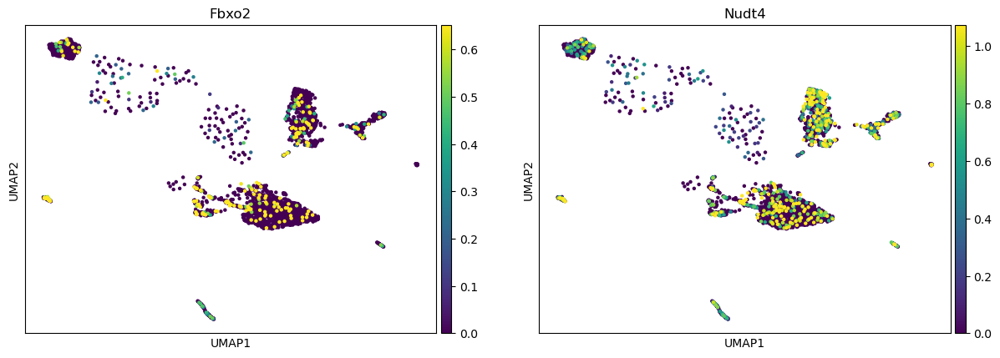

In [61]:
sc.pl.umap(adata,color=['Fbxo2','Nudt4'],layer='log1p',vmax='p95')

[Executed on 2023-10-09 11:02:19.168419]


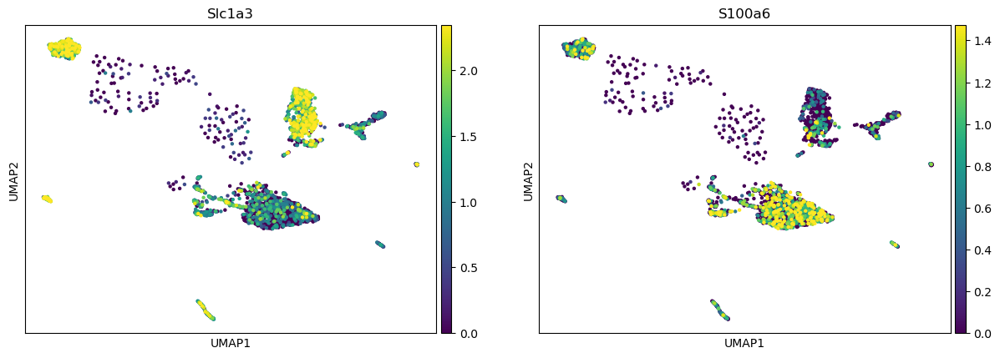

In [62]:
sc.pl.umap(adata,color=['Slc1a3','S100a6'],layer='log1p',vmax='p95')

[Executed on 2023-10-09 11:21:52.803542]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


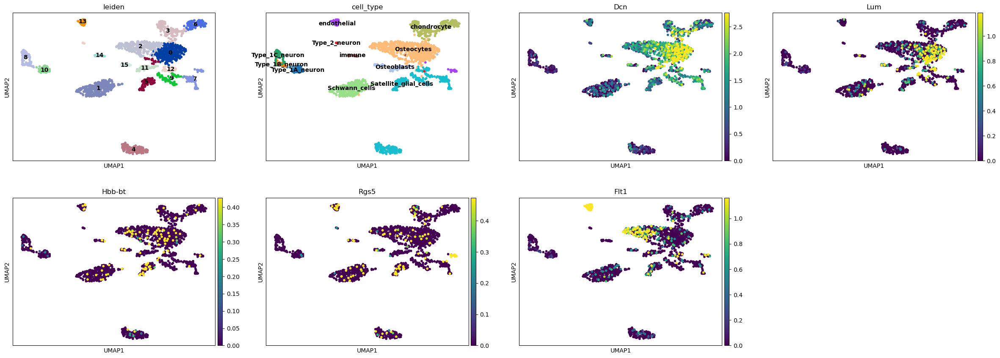

In [68]:
sc.pl.umap(known_cluster,color=['leiden','cell_type','Dcn','Lum','Hbb-bt','Rgs5','Flt1'],legend_loc='on data',vmax='p95',layer='log1p')

[Executed on 2023-10-09 11:22:35.905576]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


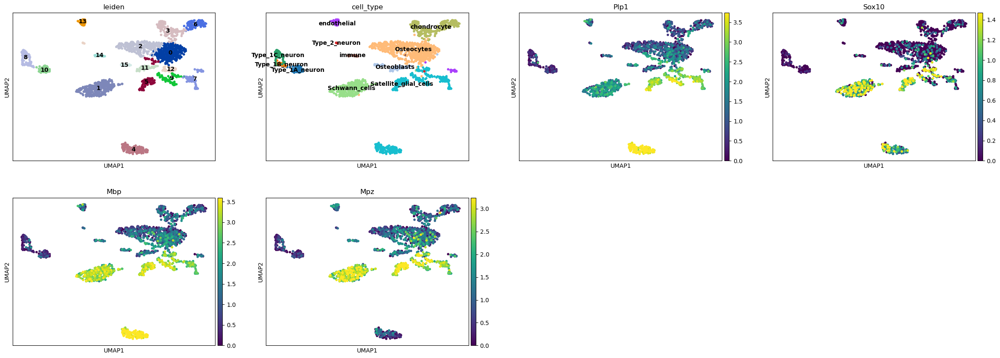

In [69]:
sc.pl.umap(known_cluster,color=['leiden','cell_type','Plp1','Sox10','Mbp','Mpz'],legend_loc='on data',vmax='p95',layer='log1p')

[Executed on 2023-10-09 11:27:45.797364]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


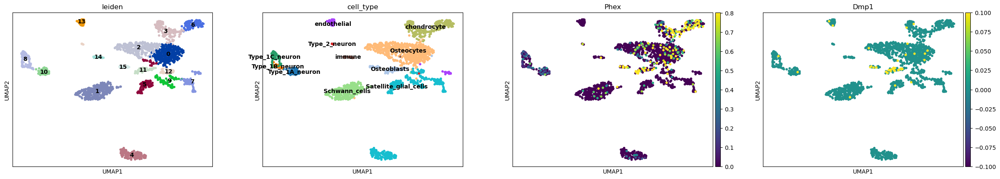

In [70]:
sc.pl.umap(known_cluster,color=['leiden','cell_type','Phex','Dmp1'],legend_loc='on data',vmax='p95',layer='log1p')

[Executed on 2023-10-09 11:32:26.240066]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


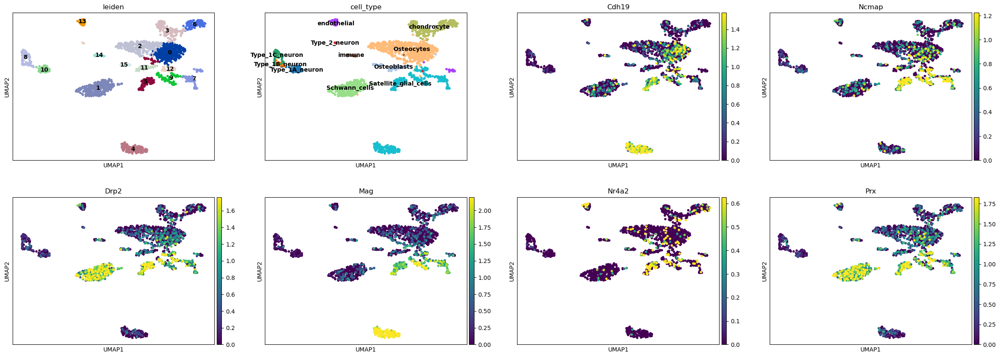

In [72]:
sc.pl.umap(known_cluster,color=['leiden','cell_type','Cdh19','Ncmap','Drp2','Mag','Nr4a2','Prx'],legend_loc='on data',vmax='p95',layer='log1p')

[Executed on 2023-10-09 11:40:34.601687]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


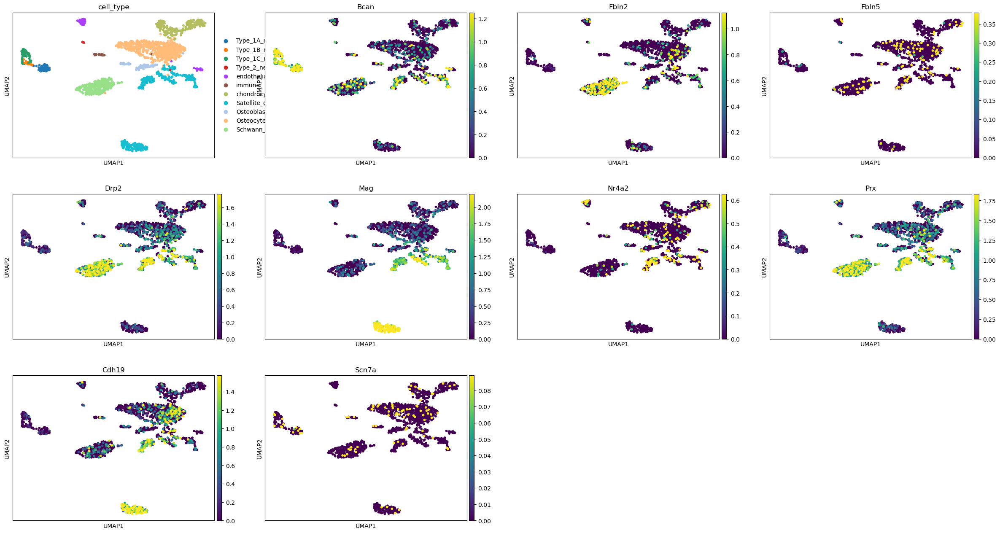

In [76]:
sc.pl.umap(known_cluster,color=['cell_type','Bcan','Fbln2','Fbln5','Drp2','Mag','Nr4a2','Prx','Cdh19','Scn7a'],vmax='p95',layer='log1p')

In [77]:
known_cluster

[Executed on 2023-10-09 11:47:56.047112]


AnnData object with n_obs × n_vars = 1772 × 33241
    obs: 'sample_ID_Plate', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'doublet_scores', 'predicted_doublets', 'sex', 'leiden_new', 'leiden_old', 'leiden_0', 'leiden_2', 'cell_type'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'cell_type_colors', 'hvg', 'leiden', 'leiden_2_colors', 'leiden_colors', 'leiden_new_colors', 'leiden_old_colors', 'leiden_sub_colors', 'log1p', 'neighbors', 'rank_genes_groups', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap', 'X_umapOriginal', 'X_umap_before'
    varm: 'PCs'
    layers: 'Scale', 'log1p', 'umi'
    obsp: 'connectivities', 'distances'

[Executed on 2023-10-09 14:08:12.461585]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


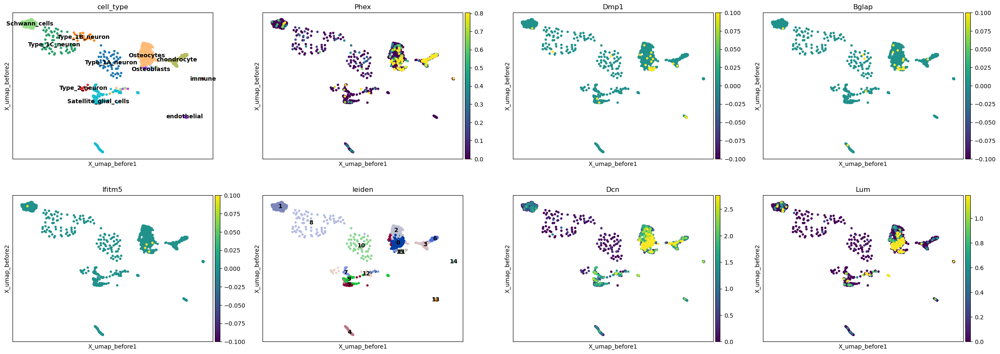

In [120]:
sc.pl.embedding(known_cluster,basis='X_umap_before',color=['cell_type','Phex','Dmp1','Bglap','Ifitm5','leiden','Dcn','Lum'],legend_loc='on data',vmax='p95',layer='log1p')

[Executed on 2023-10-09 14:08:25.504155]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


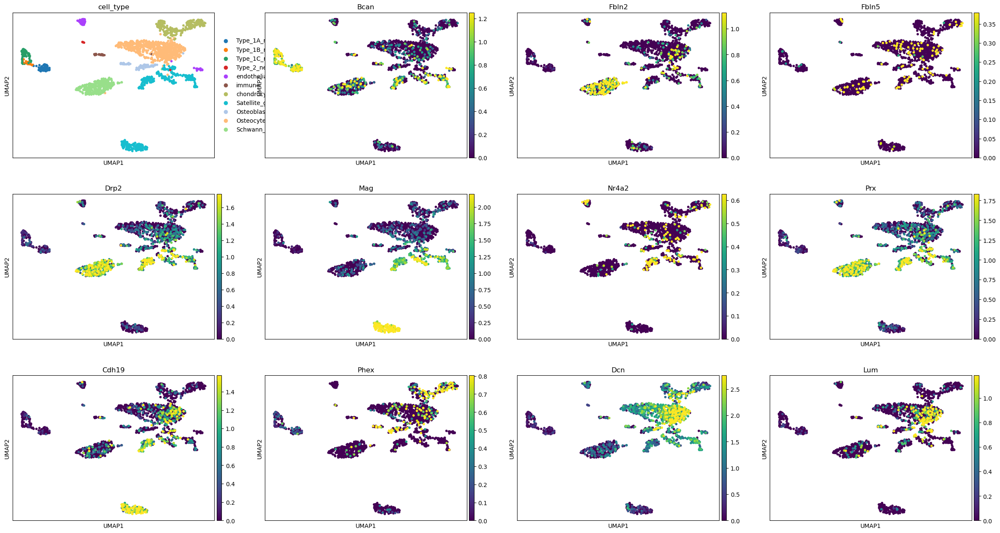

In [121]:
sc.pl.umap(known_cluster,color=['cell_type','Bcan','Fbln2','Fbln5','Drp2','Mag','Nr4a2','Prx','Cdh19','Phex','Dcn','Lum'],vmax='p95',layer='log1p')

In [90]:
known_cluster

[Executed on 2023-10-09 12:13:01.198331]


AnnData object with n_obs × n_vars = 1772 × 33241
    obs: 'sample_ID_Plate', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'doublet_scores', 'predicted_doublets', 'sex', 'leiden_new', 'leiden_old', 'leiden_0', 'leiden_2', 'cell_type'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'cell_type_colors', 'hvg', 'leiden', 'leiden_2_colors', 'leiden_colors', 'leiden_new_colors', 'leiden_old_colors', 'leiden_sub_colors', 'log1p', 'neighbors', 'rank_genes_groups', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap', 'X_umapOriginal', 'X_umap_before'
    varm: 'PCs'
    layers: 'Scale', 'log1p', 'umi'
    obsp: 'connectivities', 'distances'

[Executed on 2023-10-09 12:15:04.998004]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


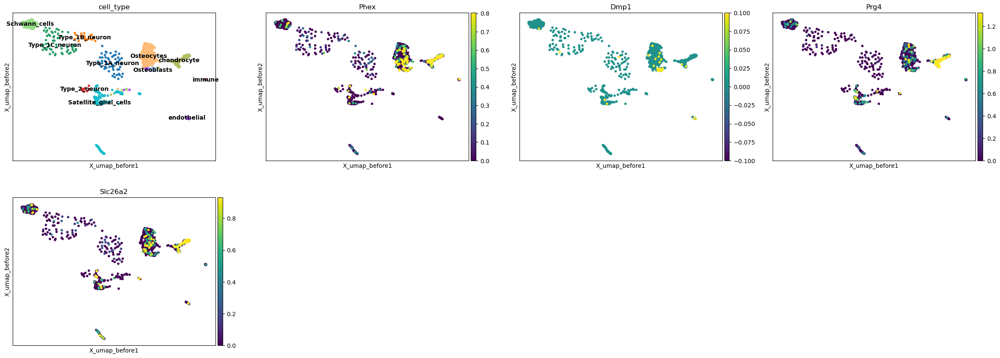

In [95]:
sc.pl.embedding(known_cluster,basis='X_umap_before',color=['cell_type','Phex','Dmp1','Prg4','Slc26a2'],layer='log1p',vmax='p95',legend_loc='on data')

[Executed on 2023-10-09 14:19:03.565041]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


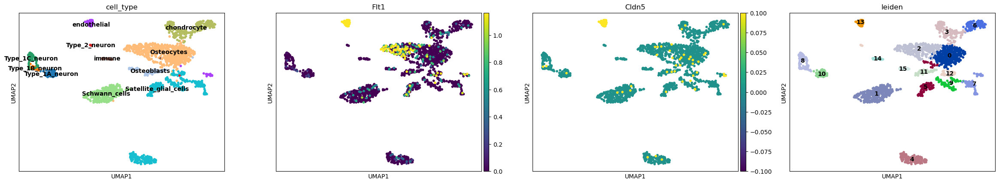

In [132]:
sc.pl.umap(known_cluster,color=['cell_type','Flt1','Cldn5','leiden'],layer='log1p',vmax='p95',legend_loc='on data')

In [55]:
known_cluster.write_h5ad("/proj/sensoryaging/data/data/up_dated_data/SGNs/final_with_neuronIV_with_annotated_subset_without_unknown_repca.h5ad")

[Executed on 2023-10-11 15:56:57.231088]


[Executed on 2023-10-09 12:23:55.807360]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


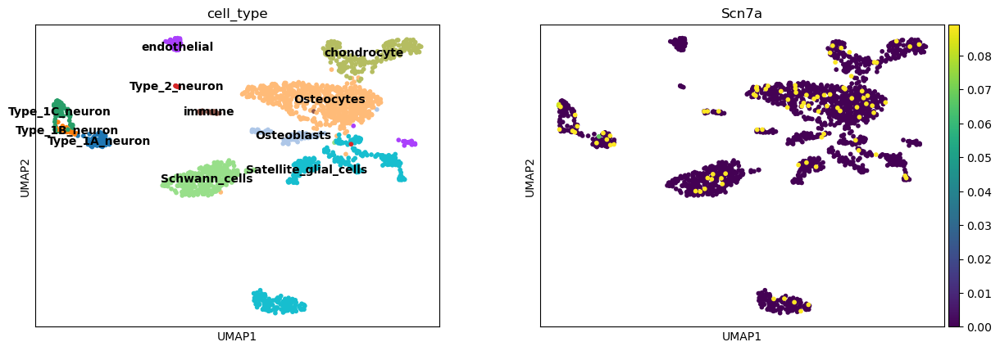

In [100]:
sc.pl.umap(known_cluster,color=['cell_type','Scn7a'],layer='log1p',vmax='p95',legend_loc='on data')

[Executed on 2023-10-09 12:25:49.408761]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


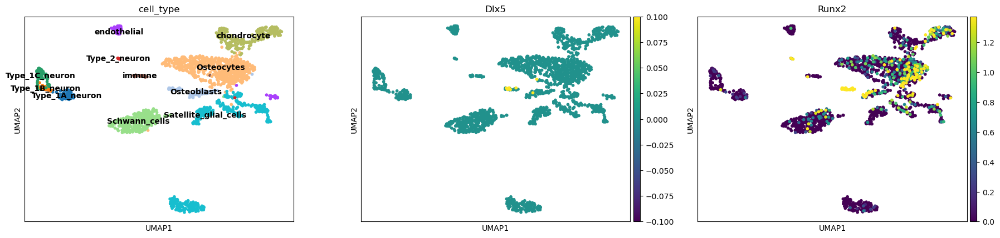

In [101]:
sc.pl.umap(known_cluster,color=['cell_type','Dlx5','Runx2'],layer='log1p',vmax='p95',legend_loc='on data')

[Executed on 2023-10-09 14:15:03.096056]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


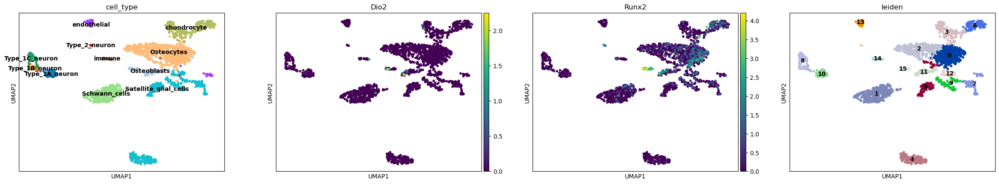

In [128]:
sc.pl.umap(known_cluster,color=['cell_type','Dio2','Runx2','leiden'],layer='log1p',legend_loc='on data')

[Executed on 2023-10-09 14:11:57.326766]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


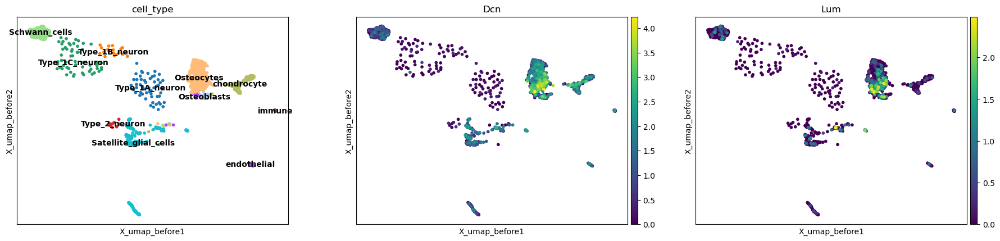

In [122]:
sc.pl.embedding(known_cluster,basis='X_umap_before',color=['cell_type','Dcn','Lum'],layer='log1p',legend_loc='on data')

[Executed on 2023-10-09 13:41:27.807842]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


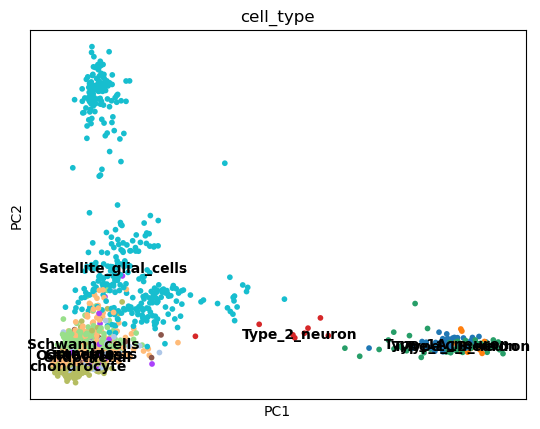

In [104]:
sc.pl.pca(known_cluster,color=['cell_type'],legend_loc='on data')

[Executed on 2023-10-09 14:00:21.111733]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


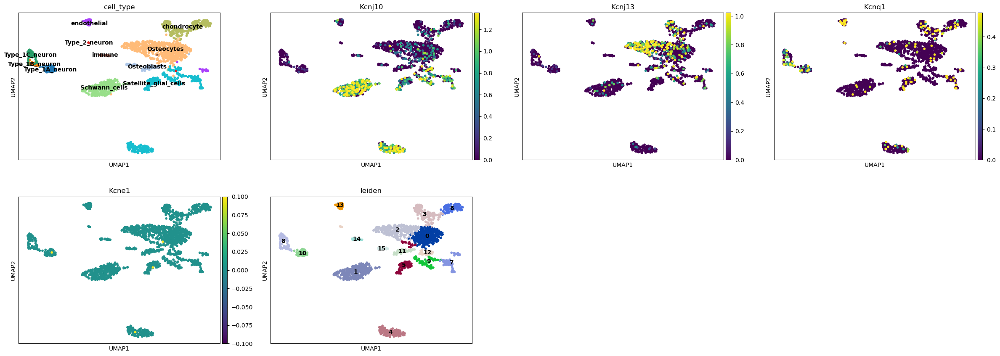

In [116]:
sc.pl.umap(known_cluster,color=['cell_type','Kcnj10','Kcnj13','Kcnq1','Kcne1','leiden'],layer='log1p',legend_loc='on data',vmax='p95')

[Executed on 2023-10-09 14:21:26.795200]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


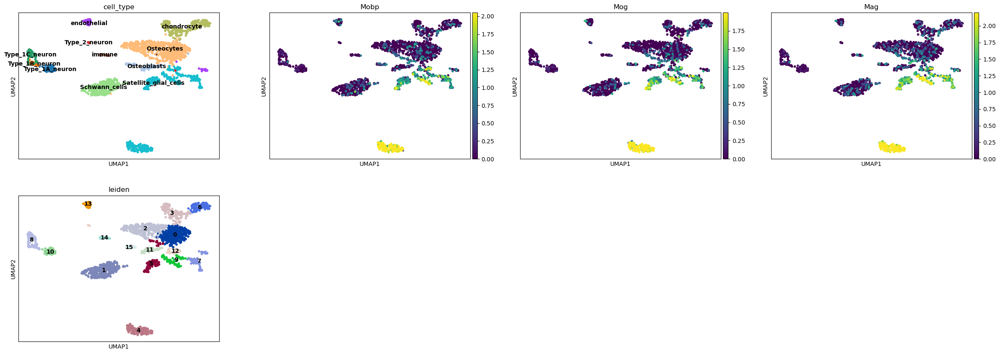

In [134]:
sc.pl.umap(known_cluster,color=['cell_type','Mobp','Mog','Mag','leiden'],layer='log1p',vmax='p95',legend_loc='on data')

[Executed on 2023-10-09 15:31:00.724975]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


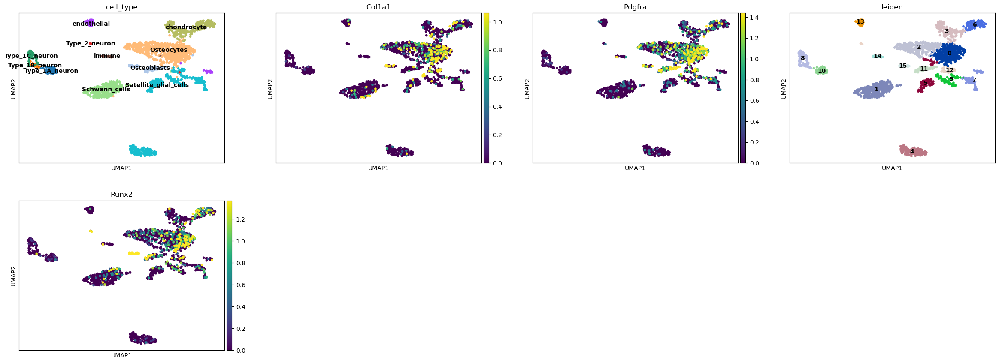

In [144]:
sc.pl.umap(known_cluster,color=['cell_type','Col1a1','Pdgfra','leiden','Runx2'],layer='log1p',vmax='p95',legend_loc='on data',vmin='p5')

[Executed on 2023-10-09 15:30:30.869694]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


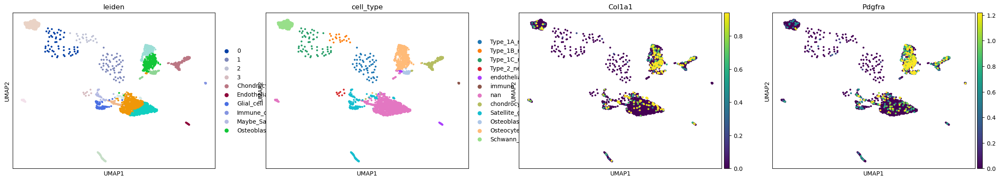

In [143]:
sc.pl.umap(adata,color=['leiden','cell_type','Col1a1','Pdgfra'],vmax='p95',layer='log1p')

In [4]:
import scanpy as sc

[Executed on 2023-10-11 13:50:12.390553]


In [3]:
known_cluster=sc.read_h5ad("/proj/sensoryaging/data/data/up_dated_data/SGNs/final_with_neuronIV_with_annotated_subset_without_unknown_repca.h5ad")

[Executed on 2023-10-13 13:47:59.577440]


In [3]:
known_cluster

[Executed on 2023-10-10 13:40:34.721815]


AnnData object with n_obs × n_vars = 1772 × 33241
    obs: 'sample_ID_Plate', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'doublet_scores', 'predicted_doublets', 'sex', 'leiden_new', 'leiden_old', 'leiden_0', 'leiden_2', 'cell_type'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'cell_type_colors', 'hvg', 'leiden', 'leiden_2_colors', 'leiden_colors', 'leiden_new_colors', 'leiden_old_colors', 'leiden_sub_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap', 'X_umapOriginal', 'X_umap_before'
    varm: 'PCs'
    layers: 'Scale', 'log1p', 'umi'
    obsp: 'connectivities', 'distances'

[Executed on 2023-10-10 13:41:57.654031]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


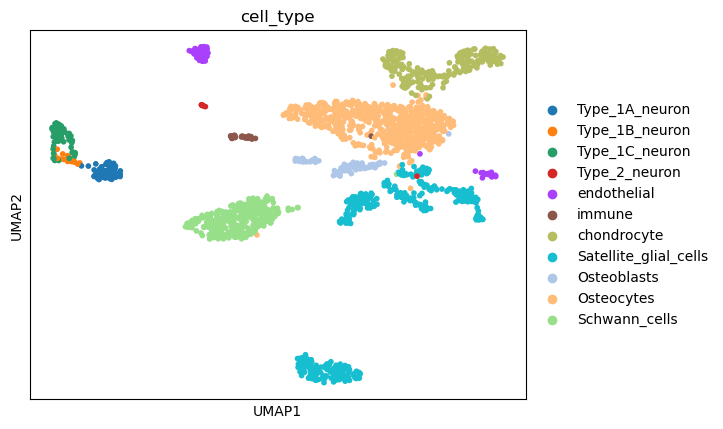

In [4]:
sc.pl.umap(known_cluster,color='cell_type')

[Executed on 2023-10-10 13:42:37.345846]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


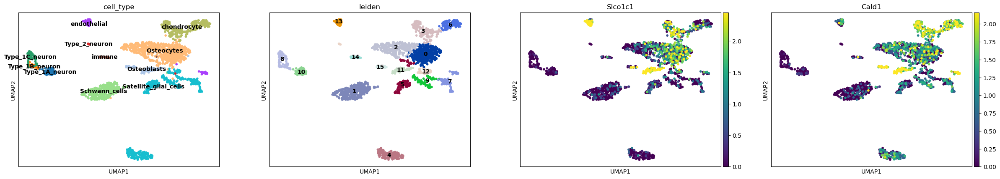

In [6]:
sc.pl.umap(known_cluster,color=['cell_type','leiden','Slco1c1','Cald1'],legend_loc='on data',vmax='p95',layer='log1p')

[Executed on 2023-10-10 13:47:08.881283]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


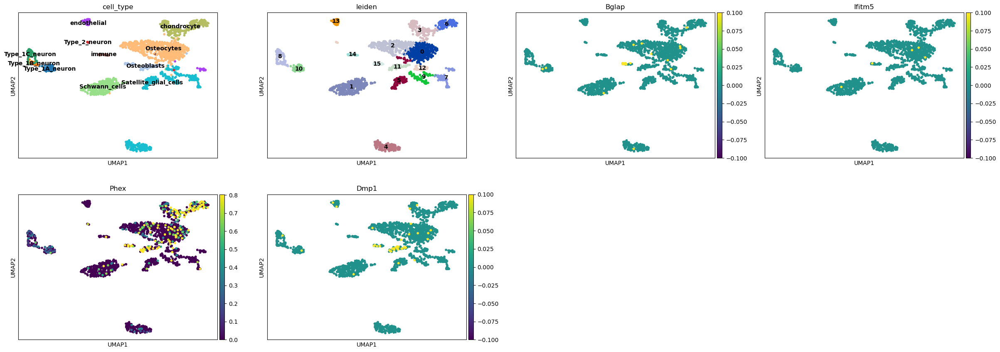

In [12]:
sc.pl.umap(known_cluster,color=['cell_type','leiden','Bglap','Ifitm5','Phex','Dmp1'],legend_loc='on data',layer='log1p',vmax='p95')

[Executed on 2023-10-10 13:48:50.131704]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


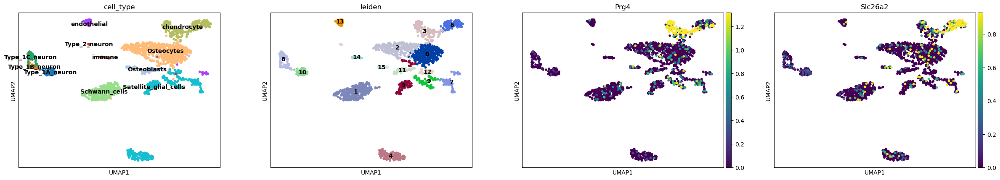

In [13]:
sc.pl.umap(known_cluster,color=['cell_type','leiden','Prg4','Slc26a2'],legend_loc='on data',layer='log1p',vmax='p95')

In [23]:
adata

[Executed on 2023-10-10 13:56:28.939575]


AnnData object with n_obs × n_vars = 2954 × 33241
    obs: 'sample_ID_Plate', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'doublet_scores', 'predicted_doublets', 'sex', 'leiden_new', 'leiden_old', 'leiden_0', 'leiden_2', 'cell_type'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'cell_type_colors', 'hvg', 'leiden', 'leiden_2_colors', 'leiden_colors', 'leiden_new_colors', 'leiden_old_colors', 'leiden_sub_colors', 'log1p', 'neighbors', 'rank_genes_groups'
    obsm: 'X_pca', 'X_umap', 'X_umapOriginal'
    layers: 'Scale', 'log1p', 'umi'
    obsp: 'connectivities', 'distances'

[Executed on 2023-10-10 13:56:48.058386]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


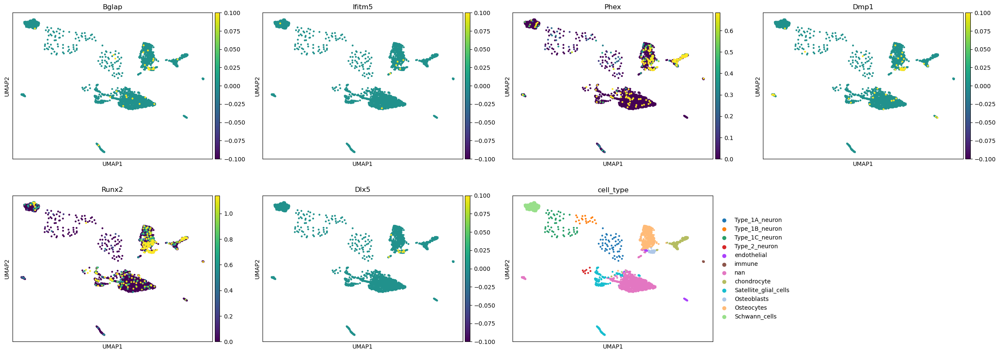

In [25]:
sc.pl.umap(adata,color=['Bglap','Ifitm5','Phex','Dmp1','Runx2','Dlx5','cell_type'],layer='log1p',vmax='p95')

[Executed on 2023-10-10 14:02:26.110812]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


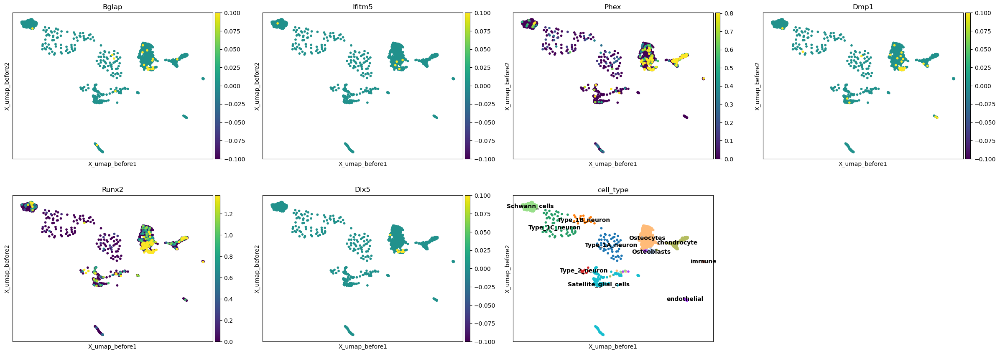

In [27]:
sc.pl.embedding(known_cluster,basis='X_umap_before',color=['Bglap','Ifitm5','Phex','Dmp1','Runx2','Dlx5','cell_type'],layer='log1p',legend_loc='on data',vmax='p95')

[Executed on 2023-10-10 14:09:50.318032]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


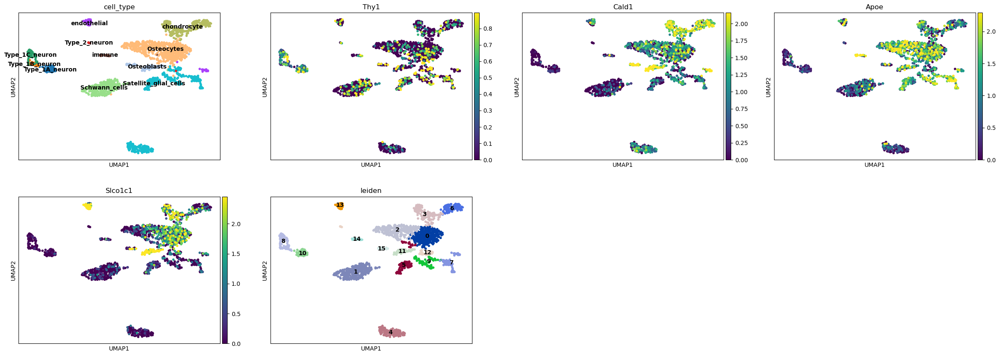

In [31]:
sc.pl.umap(known_cluster,color=['cell_type','Thy1','Cald1','Apoe','Slco1c1','leiden'],layer='log1p',vmax='p95',legend_loc='on data')

[Executed on 2023-10-10 14:24:50.316873]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


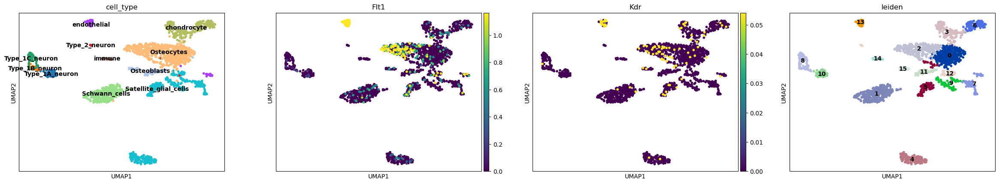

In [38]:
sc.pl.umap(known_cluster,color=['cell_type','Flt1','Kdr','leiden'],layer='log1p',vmax='p95',legend_loc='on data')

[Executed on 2023-10-10 14:36:20.522543]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


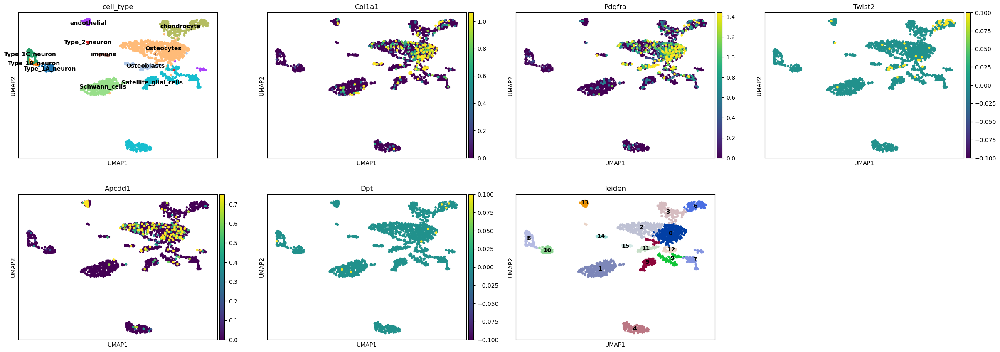

In [39]:
sc.pl.umap(known_cluster,color=['cell_type','Col1a1','Pdgfra','Twist2','Apcdd1','Dpt','leiden'],layer='log1p',vmax='p95',legend_loc='on data')

[Executed on 2023-10-11 13:57:32.470655]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


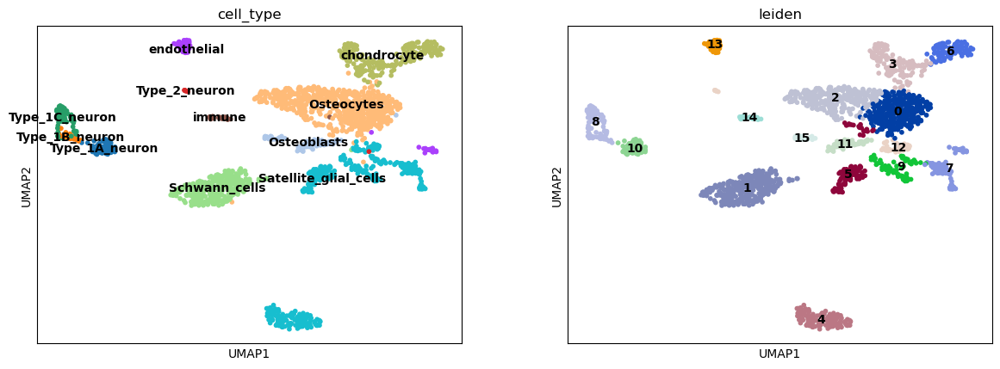

In [17]:
sc.pl.umap(known_cluster,color=['cell_type','leiden'],layer='log1p',vmax='p95',legend_loc='on data')

In [16]:
known_cluster.obs['leiden'].value_counts()

[Executed on 2023-10-11 13:56:57.484705]


leiden
0     310
1     305
2     265
3     125
4     124
5     103
6      88
7      78
8      76
9      67
10     53
11     52
12     46
13     39
14     21
15     20
Name: count, dtype: int64

In [15]:
known_cluster

[Executed on 2023-10-11 13:56:46.623546]


AnnData object with n_obs × n_vars = 1772 × 33241
    obs: 'sample_ID_Plate', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'doublet_scores', 'predicted_doublets', 'sex', 'leiden_new', 'leiden_old', 'leiden_0', 'leiden_2', 'cell_type'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'cell_type_colors', 'hvg', 'leiden', 'leiden_2_colors', 'leiden_colors', 'leiden_new_colors', 'leiden_old_colors', 'leiden_sub_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap', 'X_umapOriginal', 'X_umap_before'
    varm: 'PCs'
    layers: 'Scale', 'log1p', 'umi'
    obsp: 'connectivities', 'distances'

In [23]:
if 'Fibrocyte' not in known_cluster.obs['cell_type'].cat.categories:
    known_cluster.obs['cell_type']= known_cluster.obs['cell_type'].cat.add_categories(['Fibrocyte'])

known_cluster.obs.loc[known_cluster.obs['leiden']=='0','cell_type']='Fibrocyte'

known_cluster.obs['cell_type'].value_counts()

[Executed on 2023-10-11 14:02:56.127740]


cell_type
Satellite_glial_cells    368
Fibrocyte                310
Schwann_cells            306
Osteocytes               295
chondrocyte              207
Osteoblasts               72
Type_1C_neuron            56
endothelial               56
Type_1A_neuron            54
immune                    21
Type_1B_neuron            19
Type_2_neuron              8
Name: count, dtype: int64

In [25]:
known_cluster.obs['leiden'].value_counts()

[Executed on 2023-10-11 14:03:47.403858]


leiden
0     310
1     305
2     265
3     125
4     124
5     103
6      88
7      78
8      76
9      67
10     53
11     52
12     46
13     39
14     21
15     20
Name: count, dtype: int64

In [27]:
intersection_indce=known_cluster.obs.index[(known_cluster.obs['leiden']=='7')& (known_cluster.obs['cell_type']=='endothelial')]

if 'Pericytes' not in known_cluster.obs['cell_type'].cat.categories:
    known_cluster.obs['cell_type']=known_cluster.obs['cell_type'].cat.add_categories(['Pericytes'])

known_cluster.obs.loc[intersection_indce,'cell_type']='Pericytes'

known_cluster.obs['cell_type'].value_counts()

[Executed on 2023-10-11 14:13:03.025286]


cell_type
Satellite_glial_cells    368
Fibrocyte                310
Schwann_cells            306
Osteocytes               295
chondrocyte              207
Osteoblasts               72
Type_1C_neuron            56
Type_1A_neuron            54
endothelial               39
immune                    21
Type_1B_neuron            19
Pericytes                 17
Type_2_neuron              8
Name: count, dtype: int64

[Executed on 2023-10-11 14:13:06.447179]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


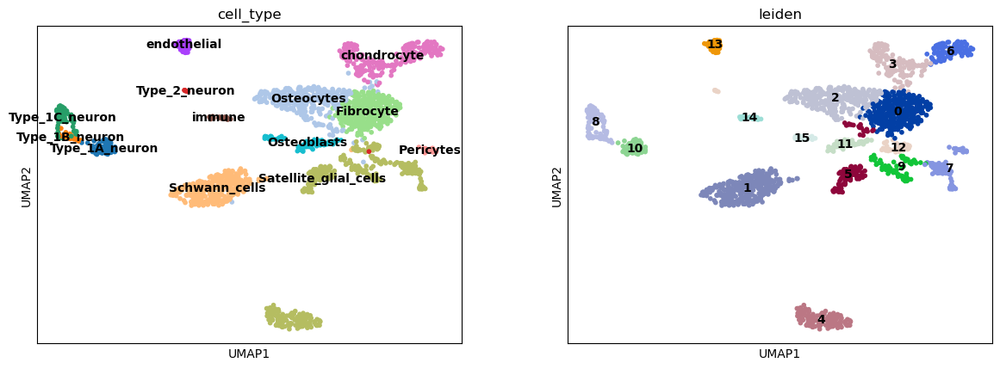

In [28]:
sc.pl.umap(known_cluster,color=['cell_type','leiden'],layer='log1p',legend_loc='on data')

In [42]:
known_cluster

[Executed on 2023-10-11 14:24:40.839294]


AnnData object with n_obs × n_vars = 1772 × 33241
    obs: 'sample_ID_Plate', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'doublet_scores', 'predicted_doublets', 'sex', 'leiden_new', 'leiden_old', 'leiden_0', 'leiden_2', 'cell_type'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'cell_type_colors', 'hvg', 'leiden', 'leiden_2_colors', 'leiden_colors', 'leiden_new_colors', 'leiden_old_colors', 'leiden_sub_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_umap', 'X_umapOriginal', 'X_umap_before', 'X_pca_2nd'
    varm: 'PCs'
    layers: 'Scale', 'log1p', 'umi'
    obsp: 'connectivities', 'distances'

In [43]:
known_cluster.obsm['X_umap_2nd']=known_cluster.obsm['X_umap'].copy()

[Executed on 2023-10-11 14:25:04.103756]


[Executed on 2023-10-11 14:25:08.057231]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


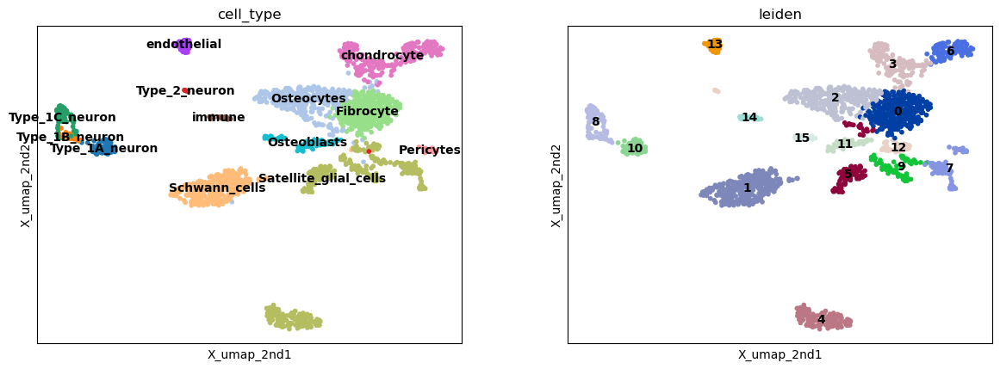

In [44]:
sc.pl.embedding(known_cluster,basis='X_umap_2nd',color=['cell_type','leiden'],layer='log1p',legend_loc='on data')

In [29]:
adata

[Executed on 2023-10-11 14:13:29.256036]


AnnData object with n_obs × n_vars = 2954 × 33241
    obs: 'sample_ID_Plate', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'doublet_scores', 'predicted_doublets', 'sex', 'leiden_new', 'leiden_old', 'leiden_0', 'leiden_2', 'cell_type'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'cell_type_colors', 'hvg', 'leiden', 'leiden_2_colors', 'leiden_colors', 'leiden_new_colors', 'leiden_old_colors', 'leiden_sub_colors', 'log1p', 'neighbors', 'rank_genes_groups'
    obsm: 'X_pca', 'X_umap', 'X_umapOriginal'
    layers: 'Scale', 'log1p', 'umi'
    obsp: 'connectivities', 'distances'

### update subset into the main data

In [54]:
# Convert 'cell_type' column in adata to string type
adata.obs['cell_type'] = adata.obs['cell_type'].astype(str)

# Get the indices and 'cell_type' data from known_cluster
known_cluster_indices = known_cluster.obs.index
known_cluster_cell_types = known_cluster.obs['cell_type']

# Update 'cell_type' column in adata based on known_cluster
adata.obs.loc[known_cluster_indices, 'cell_type'] = known_cluster_cell_types

# Convert 'cell_type' column back to categorical type
adata.obs['cell_type'] = adata.obs['cell_type'].astype('category')

# Verify the changes
print(adata.obs['cell_type'].value_counts())


[Executed on 2023-10-11 15:56:45.104302]
cell_type
nan                      1182
Fibrocyte                 310
Schwann_cells             306
Osteocytes                295
Satellite_glial_cells     244
chondrocyte               207
Oligo                     124
Osteoblasts                72
Type_1C_neuron             56
Type_1A_neuron             54
endothelial                39
immune                     21
Type_1B_neuron             19
Pericytes                  17
Type_2_neuron               8
Name: count, dtype: int64


[Executed on 2023-10-11 14:21:11.320662]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


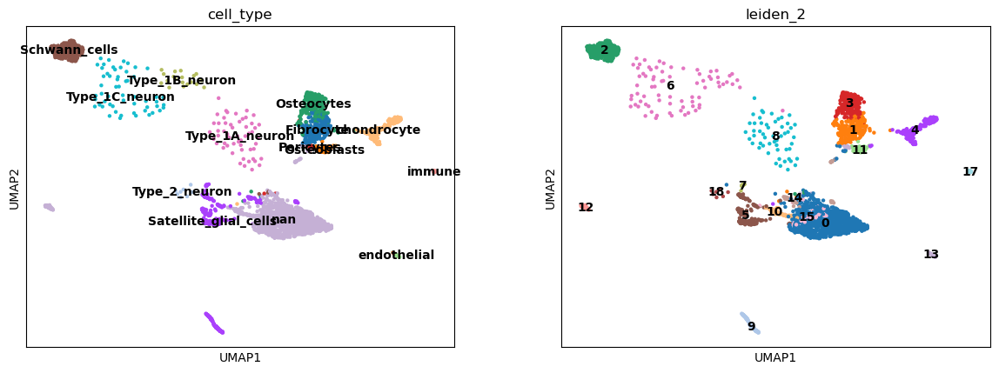

In [35]:
sc.pl.umap(adata,color=['cell_type','leiden_2',],legend_loc='on data')

[Executed on 2023-10-11 14:27:08.656723]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packag

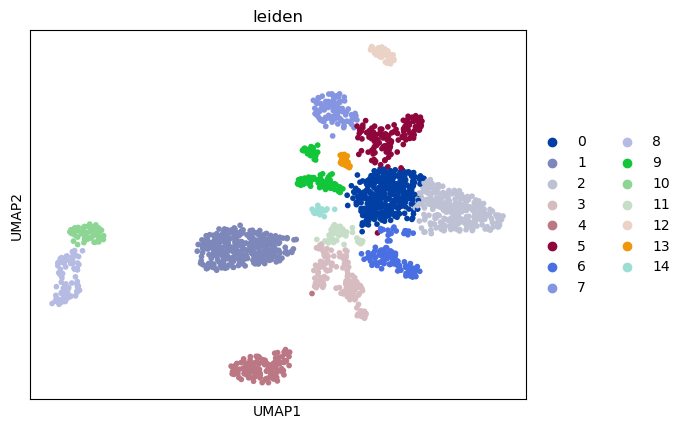

In [45]:
sc.pp.highly_variable_genes(known_cluster,flavor='seurat_v3',n_top_genes=1000,layer='umi')

sc.pp.pca(known_cluster)

sc.pp.neighbors(known_cluster,n_neighbors=20,n_pcs=15)

sc.tl.umap(known_cluster,min_dist=0.8)

sc.tl.leiden(known_cluster,resolution=0.5)

sc.pl.umap(known_cluster,color='leiden')

[Executed on 2023-10-11 15:56:35.385359]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


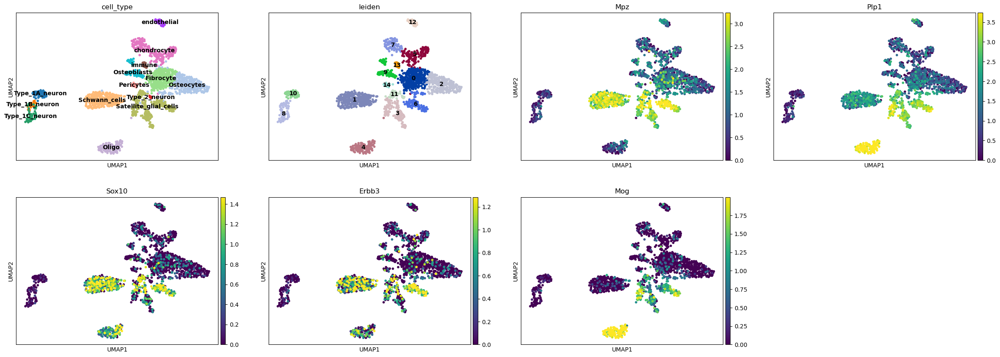

In [53]:
sc.pl.umap(known_cluster,color=['cell_type','leiden','Mpz','Plp1','Sox10','Erbb3','Mog'],legend_loc='on data',layer='log1p',vmax='p95')

[Executed on 2023-10-11 17:01:34.403136]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


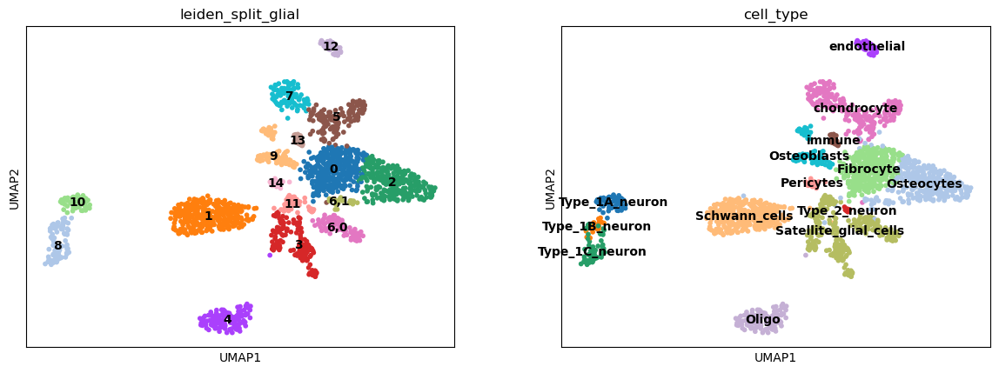

In [63]:
sc.tl.leiden(known_cluster, resolution=0.1, key_added="leiden_split_glial",restrict_to=('leiden',['6']))

sc.pl.umap(known_cluster,color=['leiden_split_glial','cell_type'],legend_loc='on data')

[Executed on 2023-10-11 17:15:41.544492]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(


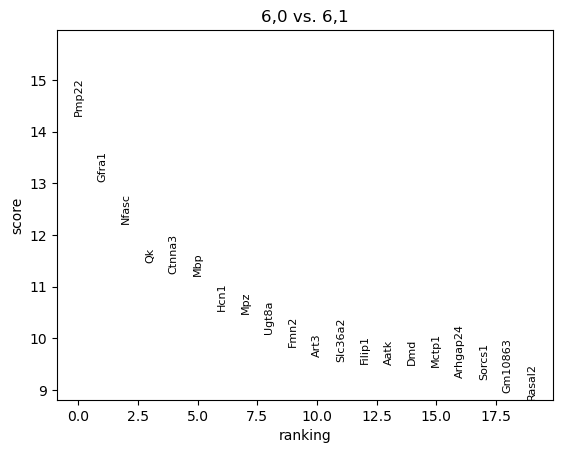

In [89]:
sc.tl.rank_genes_groups(known_cluster, groupby='leiden_split_glial', groups=['6,0'],reference='6,1', method='t-test')
sc.pl.rank_genes_groups(known_cluster, groups=['6,0'])

[Executed on 2023-10-11 17:14:13.987118]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(


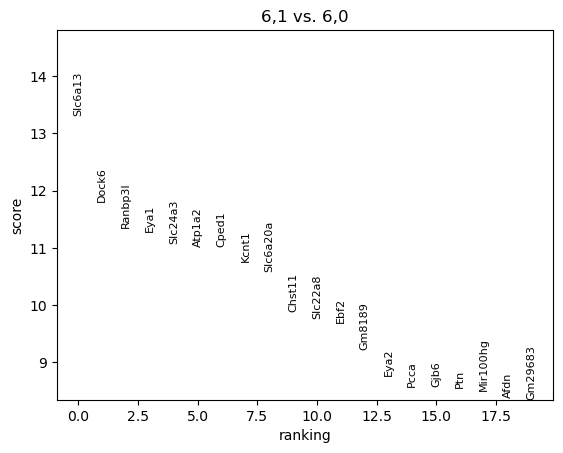

In [86]:
sc.tl.rank_genes_groups(known_cluster, groupby='leiden_split_glial', groups=['6,1'],reference='6,0', method='t-test')
sc.pl.rank_genes_groups(known_cluster, groups=['6,1'])

[Executed on 2023-10-11 17:22:07.124732]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


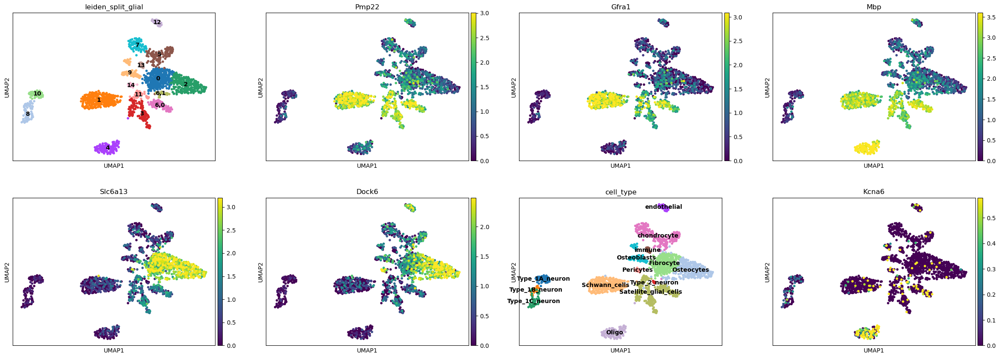

In [95]:
sc.pl.umap(known_cluster,color=['leiden_split_glial','Pmp22','Gfra1','Mbp','Slc6a13','Dock6','cell_type','Kcna6'],layer='log1p',vmax='p95',legend_loc='on data')

[Executed on 2023-10-11 17:19:00.251003]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


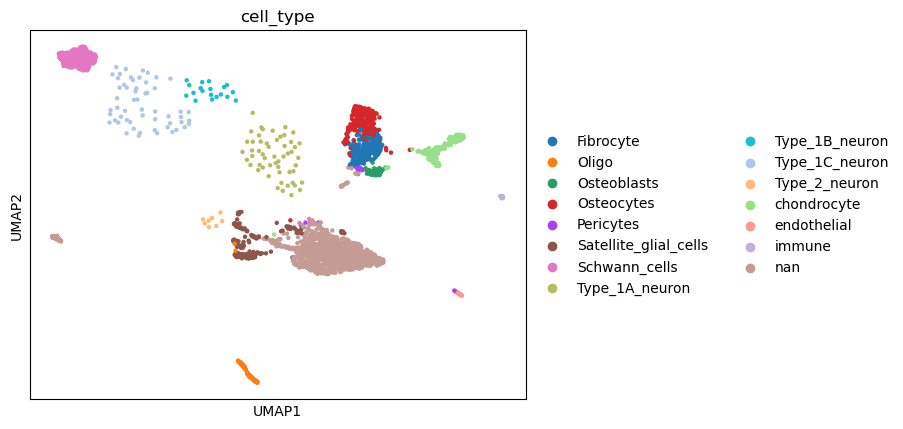

In [92]:
sc.pl.umap(adata,color=['cell_type'])

In [71]:
known_cluster

[Executed on 2023-10-11 17:05:13.319226]


AnnData object with n_obs × n_vars = 1772 × 33241
    obs: 'sample_ID_Plate', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'doublet_scores', 'predicted_doublets', 'sex', 'leiden_new', 'leiden_old', 'leiden_0', 'leiden_2', 'cell_type', 'leiden_split_glial'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'cell_type_colors', 'hvg', 'leiden', 'leiden_2_colors', 'leiden_colors', 'leiden_new_colors', 'leiden_old_colors', 'leiden_sub_colors', 'neighbors', 'pca', 'rank_genes_groups', 'umap', 'leiden_split_glial_colors'
    obsm: 'X_pca', 'X_umap', 'X_umapOriginal', 'X_umap_before', 'X_pca_2nd', 'X_umap_2nd'
    varm: 'PCs'
    layers: 'Scale', 'log1p', 'umi'
    obsp: 'connectivities', 'distances'

In [74]:
known_cluster.obs['leiden_split_glial'].value_counts()

[Executed on 2023-10-11 17:06:05.904800]


leiden_split_glial
0      315
1      305
2      261
3      128
4      124
5      124
7       88
6,0     85
8       76
9       72
10      53
11      46
12      39
13      21
6,1     18
14      17
Name: count, dtype: int64

In [76]:
sc.get.rank_genes_groups_df(known_cluster,pval_cutoff=0.05,group='6,0')

[Executed on 2023-10-11 17:06:40.626665]


,names,scores,logfoldchanges,pvals,pvals_adj
0,Mlip,17.097214,NaN,8.776170e-37,2.917287e-32
1,Mctp1,15.113873,NaN,4.327519e-33,7.192554e-29
2,Arhgap24,14.600780,NaN,1.026098e-29,1.136951e-25
3,Mpz,14.294498,NaN,8.004872e-28,4.434833e-24
4,Hcn1,14.132375,NaN,1.828962e-28,1.215930e-24
...,...,...,...,...,...
1664,Pcca,-6.415843,NaN,2.326335e-09,3.925366e-07
1665,Ebf1,-6.485257,NaN,2.258404e-09,3.830185e-07
1666,Lrmda,-6.777126,NaN,7.515101e-10,1.372580e-07
1667,Chst11,-6.919411,NaN,3.002365e-10,5.976144e-08


[Executed on 2023-10-13 13:48:39.462263]


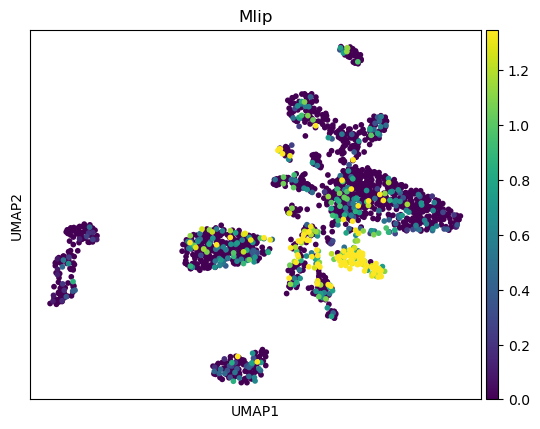

In [4]:
sc.pl.umap(known_cluster,color=['Mlip'],layer='log1p',vmax='p95')

In [52]:
if 'Oligo' not in known_cluster.obs['cell_type'].cat.categories:
    known_cluster.obs['cell_type']= known_cluster.obs['cell_type'].cat.add_categories(['Oligo'])

known_cluster.obs.loc[known_cluster.obs['leiden']=='4','cell_type']='Oligo'

known_cluster.obs['cell_type'].value_counts()

[Executed on 2023-10-11 15:56:32.418501]


cell_type
Fibrocyte                310
Schwann_cells            306
Osteocytes               295
Satellite_glial_cells    244
chondrocyte              207
Oligo                    124
Osteoblasts               72
Type_1C_neuron            56
Type_1A_neuron            54
endothelial               39
immune                    21
Type_1B_neuron            19
Pericytes                 17
Type_2_neuron              8
Name: count, dtype: int64

[Executed on 2023-10-13 14:29:57.436248]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


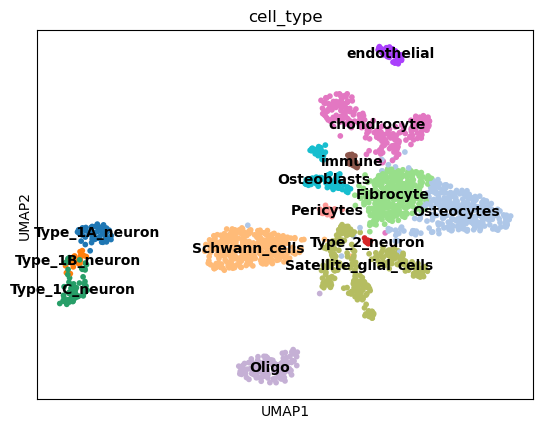

In [8]:
sc.pl.umap(known_cluster,color=['cell_type'],legend_loc='on data')

In [6]:
known_cluster

[Executed on 2023-10-13 14:29:21.723099]


AnnData object with n_obs × n_vars = 1772 × 33241
    obs: 'sample_ID_Plate', 'batch', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'doublet_scores', 'predicted_doublets', 'sex', 'leiden_new', 'leiden_old', 'leiden_0', 'leiden_2', 'cell_type'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'cell_type_colors', 'hvg', 'leiden', 'leiden_2_colors', 'leiden_colors', 'leiden_new_colors', 'leiden_old_colors', 'leiden_sub_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'umap'
    obsm: 'X_pca', 'X_pca_2nd', 'X_umap', 'X_umapOriginal', 'X_umap_2nd', 'X_umap_before'
    varm: 'PCs'
    layers: 'Scale', 'log1p', 'umi'
    obsp: 'connectivities', 'distances'

[Executed on 2023-10-13 14:30:15.770180]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


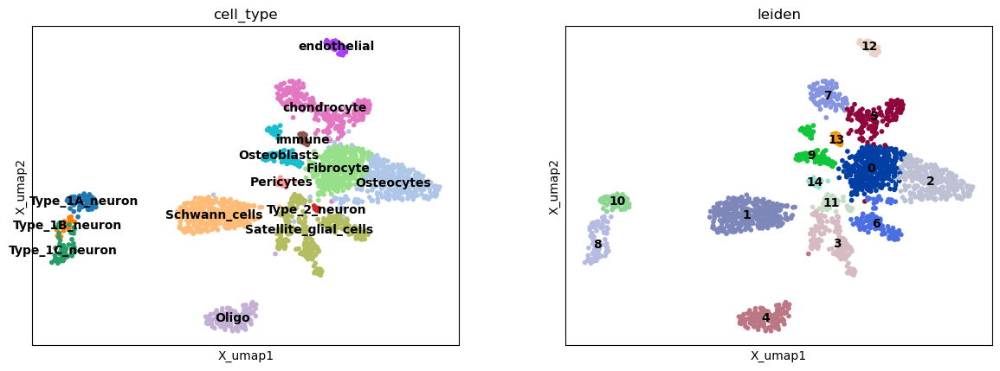

In [10]:
sc.pl.embedding(known_cluster,basis='X_umap',color=['cell_type','leiden'],layer='log1p',legend_loc='on data')

[Executed on 2023-10-13 15:01:10.502925]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


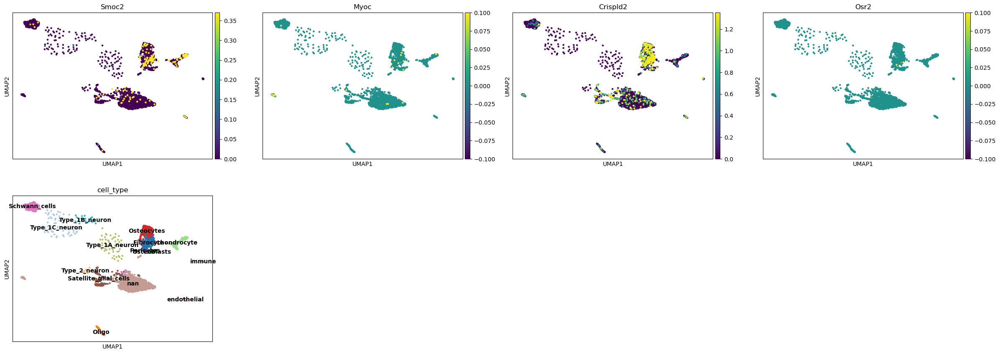

In [28]:
sc.pl.umap(adata,color=['Smoc2','Myoc','Crispld2','Osr2','cell_type'],layer='log1p',legend_loc='on data',vmax='p95')

[Executed on 2023-10-13 15:37:30.950213]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


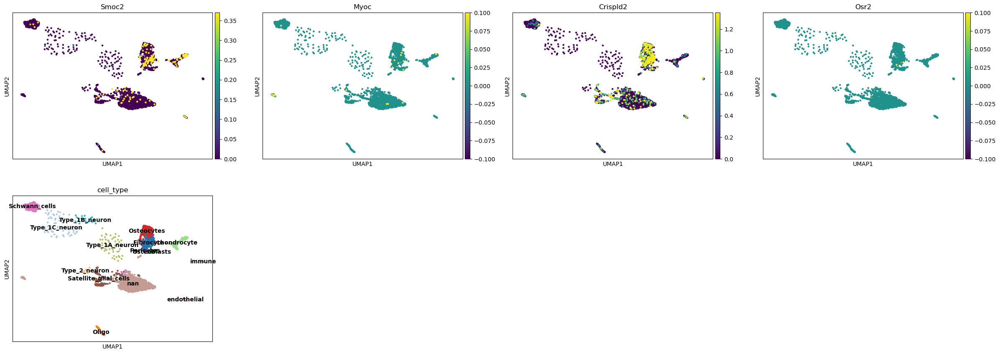

In [34]:
sc.pl.umap(adata,color=['Smoc2','Myoc','Crispld2','Osr2','cell_type'],layer='log1p',legend_loc='on data',vmax='p95')

[Executed on 2023-10-13 15:01:05.365154]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


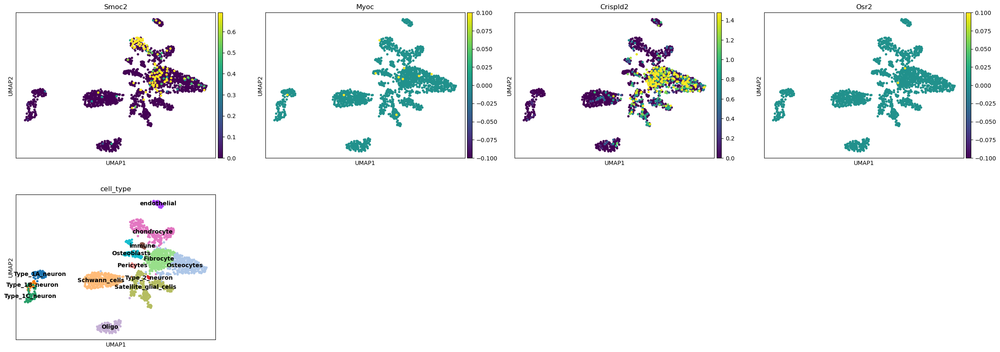

In [27]:
sc.pl.umap(known_cluster,color=['Smoc2','Myoc','Crispld2','Osr2','cell_type'],layer='log1p',legend_loc='on data',vmax='p95')

[Executed on 2023-10-13 15:41:03.858827]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


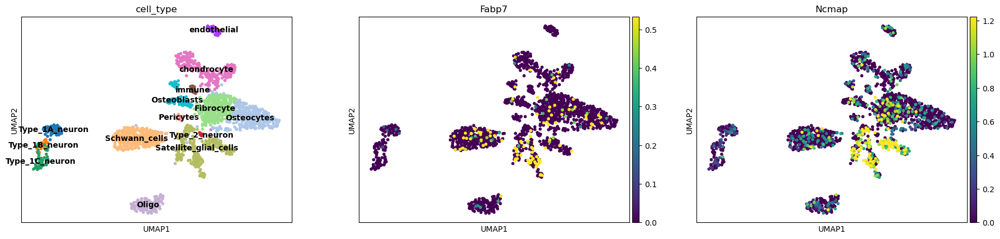

In [36]:
sc.pl.umap(known_cluster,color=['cell_type','Fabp7','Ncmap'],vmax='p95',layer='log1p',legend_loc='on data')

[Executed on 2023-10-13 15:16:36.007144]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


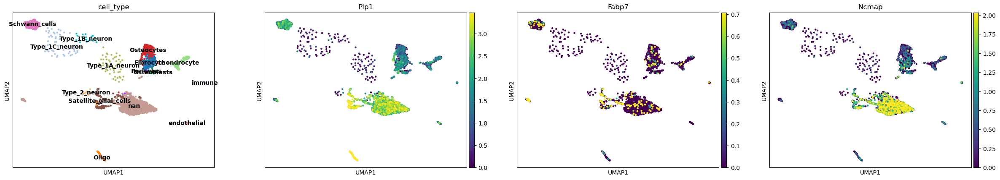

In [31]:
sc.pl.umap(adata,color=['cell_type','Plp1','Fabp7','Ncmap'],vmax='p95',layer='log1p',legend_loc='on data')

[Executed on 2023-10-13 15:24:42.221671]


/proj/sensoryaging/.conda/env/scvi-env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


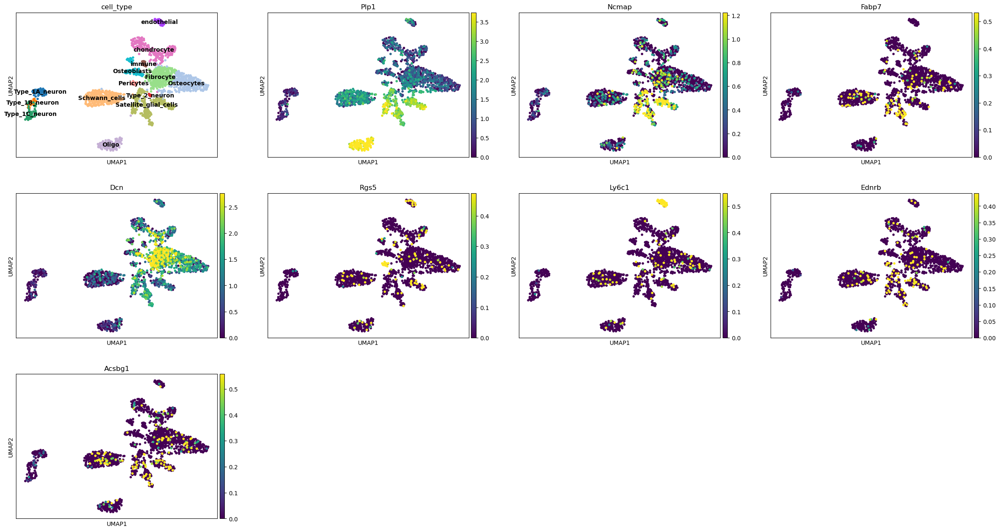

In [33]:
sc.pl.umap(known_cluster,color=['cell_type','Plp1','Ncmap','Fabp7','Dcn','Rgs5','Ly6c1','Ednrb','Acsbg1'],vmax='p95',layer='log1p',legend_loc='on data')